In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
import torchvision
from torch import nn


from PIL import Image
import copy
import albumentations as A
import cv2
from albumentations.pytorch import ToTensorV2
from albumentations.augmentations import transforms as A_transforms
from torchsampler import ImbalancedDatasetSampler
import random

In [5]:
import seaborn as sns

# 1. EDA

## 1. 기본 정보
### 1. Train data
- 사람 수 : 4500 명
- 인당 사진 수 : 7 (폴더로 구분 되어 있음)
- 이미지 크기 : (384 : 512)
- 전체 데이터의 60%

- 18개의 클래스
- Mask 착용 여부, 성별, 나이 (구분자 : 30 , 60) 의 조합에 따른 클래스 분류

### 3. Test Data
- 40% 중 20%는 Public Test Set, 나머지 20%는 Private Test Set

## 성별, 연령, 마스크 착용 여부에 따라 사진을 총 18개의 클래스로 분류

## 2. Class(Label) 분포

In [6]:
df = pd.read_csv("/opt/ml/input/data/train/train.csv")
df.head()

,id,gender,race,age,path
0,000001,female,Asian,45,000001_female_Asian_45
1,000002,female,Asian,52,000002_female_Asian_52
2,000004,male,Asian,54,000004_male_Asian_54
3,000005,female,Asian,58,000005_female_Asian_58
4,000006,female,Asian,59,000006_female_Asian_59


### 1. age 분포

<AxesSubplot:xlabel='count', ylabel='age'>

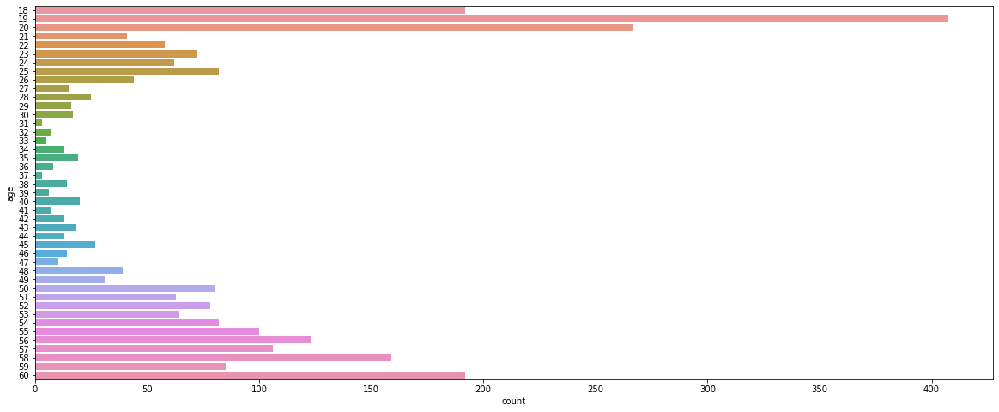

In [7]:
fig = plt.figure(figsize = (20, 8))
sns.countplot(data = df, y = 'age')

성별분포는 다음과 같이 매우 불균형하게 나타나고 있음을 알 수 있다. 추후 예측에 있어서 주요한 요인이 될 수 있다.

약간의 전처리를 해서 연령대 그룹을 나눠서 확인해보자

In [8]:
age_df = df.copy()
age_df.head()

,id,gender,race,age,path
0,000001,female,Asian,45,000001_female_Asian_45
1,000002,female,Asian,52,000002_female_Asian_52
2,000004,male,Asian,54,000004_male_Asian_54
3,000005,female,Asian,58,000005_female_Asian_58
4,000006,female,Asian,59,000006_female_Asian_59


In [9]:
def age_grouping(age):
    if age <20 :
        return '10\'s'
    elif age <30:
        return '20\'s'
    elif age < 40:
        return '30\'s'
    elif age < 50:
        return '40\'s'
    elif age < 60:
        return '50\'s'
    else:
        return '60\'s'
age_df['age(group)'] = age_df['age'].apply(age_grouping)
age_df.head(3)

,id,gender,race,age,path,age(group)
0,000001,female,Asian,45,000001_female_Asian_45,40's
1,000002,female,Asian,52,000002_female_Asian_52,50's
2,000004,male,Asian,54,000004_male_Asian_54,50's


<AxesSubplot:xlabel='age(group)', ylabel='count'>

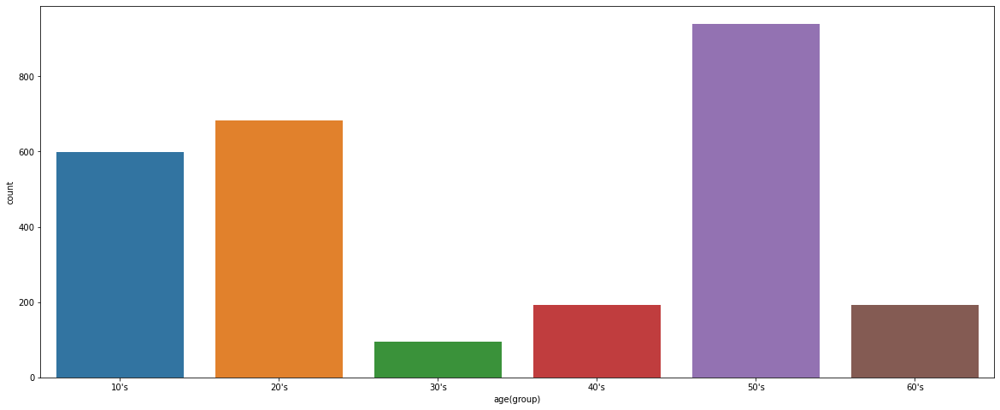

In [10]:
fig = plt.figure(figsize = (20, 8))
sns.countplot(data = age_df, x = 'age(group)', order = age_df['age(group)'].sort_values().unique())

- 그래프에서 보는 것 처럼 10대, 20대 50대가 특히 많으며 30, 40, 60대는 상대적으로 적게 나타나는 것을 확인할 수 있다.

- 이것은 추후 학습할 때 고려해야하는 주요한 요인이 될 수 있다.

- 나이 그대로 labeling 해서 모델을 각각 만들어 준다면 매우 중요한 요소가 될 수 있다.

- 하지만 사람마다 나이를 구분하기는 쉽지 않음 => 피부 디테일 등을 통해 연령대를 추측하는 정도가 될 거라 판단

## 2. 마스크 착용 여부
- 구조를 살펴보면 폴더는 같은 사람의 7개의 사진이 확인된다.

In [11]:
new_df = pd.read_csv("/opt/ml/input/data/train/new_train.csv")
new_df.tail(10)

,Id,path,label,Mask,Gender,Age,Age(int)
18890,006957,input/data/train/images/006957_male_Asian_20/m...,0,0,0,0,20
18891,006957,input/data/train/images/006957_male_Asian_20/m...,0,0,0,0,20
18892,006957,input/data/train/images/006957_male_Asian_20/m...,0,0,0,0,20
18893,006959,input/data/train/images/006959_male_Asian_19/n...,12,2,0,0,19
18894,006959,input/data/train/images/006959_male_Asian_19/i...,6,1,0,0,19
18895,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18896,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18897,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18898,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18899,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19


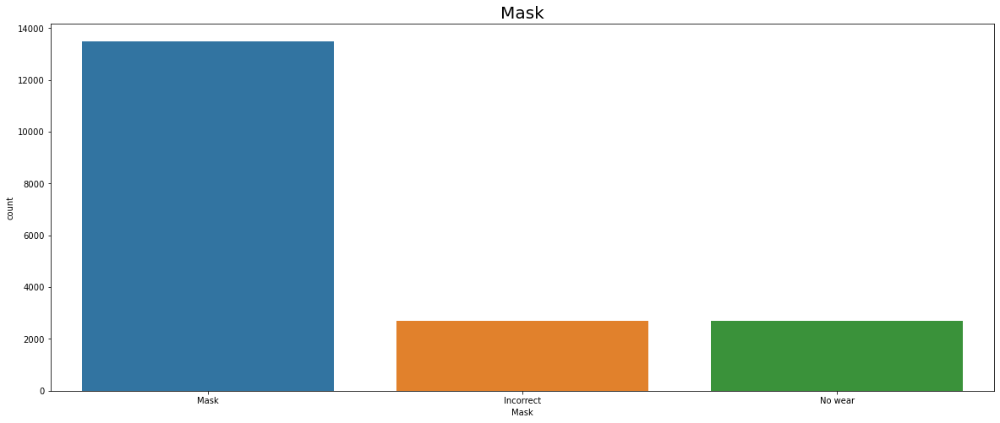

In [15]:
fig, ax = plt.subplots(figsize = (20, 8))
sns.countplot(data = new_df, x = 'Mask', ax = ax)
ax.set_xticklabels(['Mask', 'Incorrect', 'No wear'])
ax.set_title('Mask', fontsize = 20)
plt.show()

- 역시나 마스크 착용 여부에 대한 데이터도 불균형 상태이므로 학습시킬 때 고려해야하는 요소
- 또한 이미지를 직접 살펴보면 마스크는 다양한 색상으로 착용했음을 확인할 수 있음
- Incorrect 사진은 턱스크, 코스크 뿐 아니라 눈에 걸치는 등 outlier 요소들을 확인할 수 있음

## 3. 성별

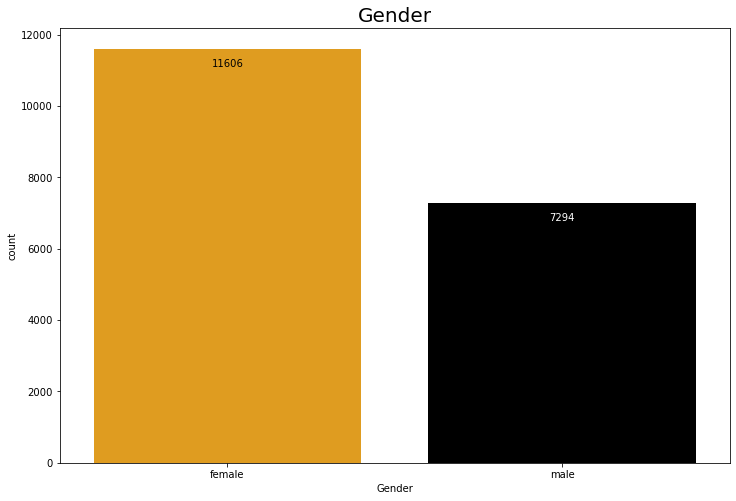

In [14]:
fig, ax = plt.subplots(figsize = (12, 8))
sns.countplot(data = new_df, x = 'Gender', palette = ['orange', 'black'], order = [1, 0], ax = ax)
for i in range(2):
    if i == 0:
        ax.text(x = i, y = len(new_df[new_df['Gender'] == 1])-500 , s = len(new_df[new_df['Gender'] == 1]), ha = 'center')
    else:
        ax.text(x = i, y = len(new_df[new_df['Gender'] == 0])-500 , s = len(new_df[new_df['Gender'] == 0]), ha = 'center', color = 'white')
ax.set_xticklabels(['female', 'male'])
ax.set_title('Gender', fontsize = 20)
plt.show()

- 성별도 마찬가지로 여성이 남성보다 더 많은 사진이 존재
- 전체 18개 클래스에 대한 비율도 살펴보자

## 4. 전체 18개 클래스

|class|mask|gender|age|
|---|---|---|---|
|0|Wear|Male|<30|
|1|Wear|Male|>=30 and <60|
|2|Wear|Male|>=60|
|3|Wear|Female|<30|
|4|Wear|Female|>=30 and <60|
|5|Wear|Female|>=60|
|6|Incorrect|Male|<30|
|7|Incorrect|Male|>=30 and <60|
|8|Incorrect|Male|>=60|
|9|Incorrect|Female|<30|
|10|Incorrect|Female|>=30 and <60|
|11|Incorrect|Female|>=60|
|12|Not Wear|Male|<30|
|13|Not Wear|Male|>=30 and <60|
|14|Not Wear|Male|>=60|
|15|Not Wear|Female|<30|
|16|Not Wear|Female|>=30 and <60|
|17|Not Wear|Female|>=60|  

Text(0.5, 1.0, '18 Class')

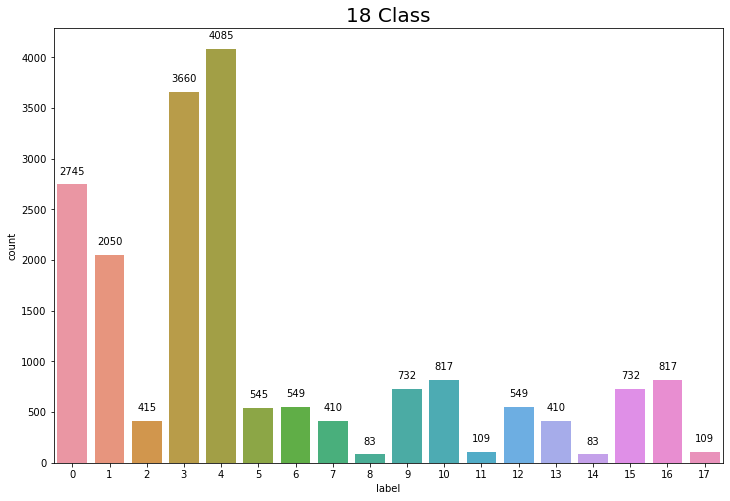

In [16]:
# sns.countplot(data = df, y = 'label')
fig = plt.figure(figsize = (12, 8))
ax = fig.add_subplot(111)
sns.countplot(data = new_df, x = 'label', ax = ax)
for i in range(18):
    ax.text(x = i, y = len(new_df[new_df['label'] == i])+100 , s = len(new_df[new_df['label'] == i]), ha = 'center')

ax.set_title('18 Class', fontsize = 20)

- 성별, 마스크 착용여부, 연령대 모두 불균형이므로 당연히 클래스별로 심각한 불균형이 나타나는 것을 확인할 수 있음
- DataLoader에서 이러한 불균형 데이터에 대한 sampler등을 고려할 필요가 있음
- 또한 Loss 업데이트 시 가중치 부여 등을 고려할 수 있음

## 5. 결측치 확인

In [69]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2700 entries, 0 to 2699
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      2700 non-null   object
 1   gender  2700 non-null   object
 2   race    2700 non-null   object
 3   age     2700 non-null   int64 
 4   path    2700 non-null   object
dtypes: int64(1), object(4)
memory usage: 105.6+ KB


In [70]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18900 entries, 0 to 18899
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Id      18900 non-null  object
 1   path    18900 non-null  object
 2   label   18900 non-null  int64 
 3   Mask    18900 non-null  int64 
 4   Gender  18900 non-null  int64 
 5   Age     18900 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 886.1+ KB


In [72]:
df.describe(include = 'all')

,id,gender,race,age,path
count,2700,2700,2700,2700.000000,2700
unique,2699,2,1,NaN,2700
top,003397,female,Asian,NaN,000001_female_Asian_45
freq,2,1658,2700,NaN,1
mean,NaN,NaN,NaN,37.708148,NaN
std,NaN,NaN,NaN,16.985904,NaN
min,NaN,NaN,NaN,18.000000,NaN
25%,NaN,NaN,NaN,20.000000,NaN
50%,NaN,NaN,NaN,36.000000,NaN
75%,NaN,NaN,NaN,55.000000,NaN


- 003397 Id가 두개 있지만 확인 결과 다른 사람으로 확인되었으며 나이 정보가 다르게 나오므로 큰 문제는 없음
- 기타 결측치는 존재하지 않음
- 하지만 성별 labeling이 잘못되어있는 데이터가 존재 
    - 많은것은 아니지만 추후 성능향상을 위해 고쳐야 하는 것도 체크
    - Noise로 생각하고 그대로 먼저 학습
    - 전수조사는 매우 힘든작업


## 6. 기타
1. 같은 배경에서 찍은 경우가 많음
2. 같은 사람은 같은 장소에서 마스크 착용만 바꿔서 촬영한 사진
3. Incorrect의 대부분은 코 아래로 착용함

# 2. 가설 1

- Sampler, Augmentation으로 불균형 클래스를 보완하여 잘 학습시키는 것이 중요!!
- 마스크 착용여부, 성별, 연령대를 잘 구분할 수 있다고 판단되는 Augmentation을 선택하는 것이 중요



# 3. Augmentation

- 모든 기능을 확인하면 좋지만 우선 괜찮아 보이는 기능들을 가져온 후 시각화를 통해 분석하고 확인!
- Albumentations 라이브러리 사용

### 0. 시각화를 위한 데이터셋 만들기

In [22]:
root_path = '/opt/ml'

In [5]:
root_path = '/opt/ml'
img_path1 = os.path.join(root_path,new_df['path'][0])

In [82]:
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

In [84]:
new_df.head(15)

,Id,path,label,Mask,Gender,Age
0,000001,input/data/train/images/000001_female_Asian_45...,16,2,1,1
1,000001,input/data/train/images/000001_female_Asian_45...,10,1,1,1
2,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1
3,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1
4,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1
5,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1
6,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1
7,000002,input/data/train/images/000002_female_Asian_52...,16,2,1,1
8,000002,input/data/train/images/000002_female_Asian_52...,10,1,1,1
9,000002,input/data/train/images/000002_female_Asian_52...,4,0,1,1


In [85]:
img_path2 = os.path.join(root_path,new_df['path'][1])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

In [86]:
img_path3 = os.path.join(root_path,new_df['path'][2])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

### 1. Blur
- 흐리게 만드는 효과라서 분류에 역효과가 날 수 있음
- Noise 관점에서는 Noise trans와 비교할 수 있음
- 시각화를 통해 확인

#### 1. 기본값
kernel size = 3 ~ 7 랜덤

In [83]:
trans1 = A_transforms.Blur(p = 1)

In [87]:
transformed1_img = trans1(image = image1)['image']
transformed2_img = trans1(image = image2)['image']
transformed3_img = trans1(image = image3)['image']



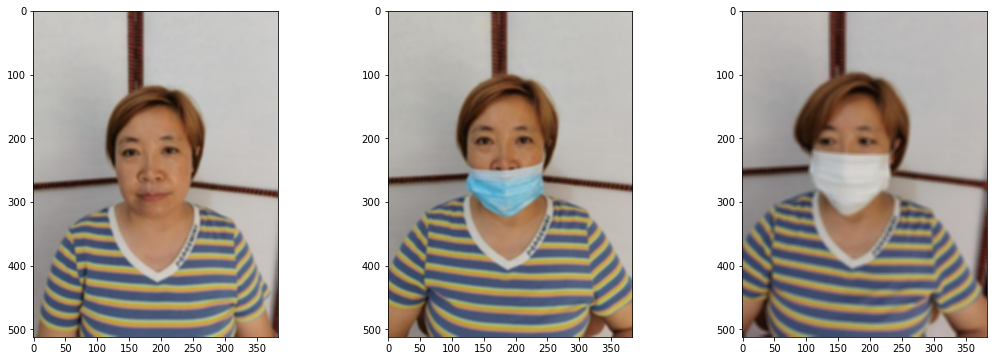

In [90]:
fig, axes = plt.subplots(1, 3, figsize = (18, 6))
axes[0].imshow(transformed1_img)
axes[1].imshow(transformed2_img)
axes[2].imshow(transformed3_img)
plt.show()

#### 2. ksize : 10

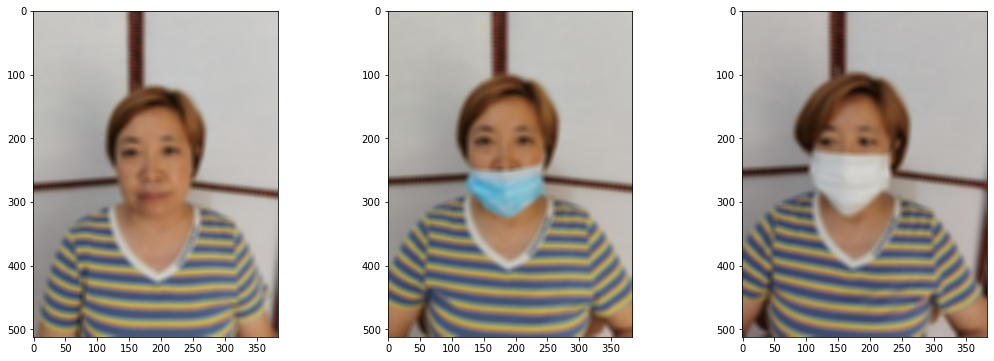

In [92]:
trans1 = A_transforms.Blur(p = 1, blur_limit = (10, 10))
transformed1_img = trans1(image = image1)['image']
transformed2_img = trans1(image = image2)['image']
transformed3_img = trans1(image = image3)['image']

fig, axes = plt.subplots(1, 3, figsize = (18, 6))
axes[0].imshow(transformed1_img)
axes[1].imshow(transformed2_img)
axes[2].imshow(transformed3_img)
plt.show()

#### 3. ksize : 20

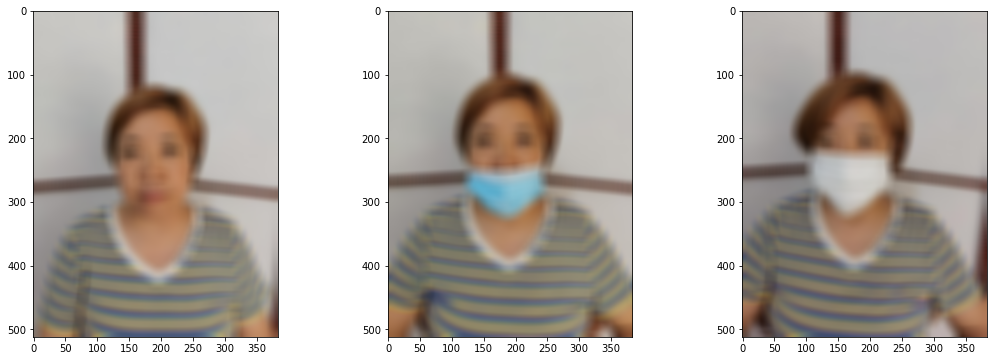

In [93]:
trans1 = A_transforms.Blur(p = 1, blur_limit = (20, 20))
transformed1_img = trans1(image = image1)['image']
transformed2_img = trans1(image = image2)['image']
transformed3_img = trans1(image = image3)['image']

fig, axes = plt.subplots(1, 3, figsize = (18, 6))
axes[0].imshow(transformed1_img)
axes[1].imshow(transformed2_img)
axes[2].imshow(transformed3_img)
plt.show()

- Blur 효과는 적절하게주면 마스크 착용여부에 대해서만 특징을 추출하기 좋은 기능으로 보임
- 피부 상태 등에 의한 연령대 요소는 확인하기 않음

### 2. CLAHE

- Contrast Limited Adaptive Histogram Equailization의 약자
- 이름 그대로의 효과를 주는 것으로 마스크 보다는 얼굴의 주름 등을 캐치하는데 좋은 효과를 보일 것이라 판단됨
- 시각화를 통해 비교하기

In [17]:
new_df[new_df['Age'] == 0].tail()

,Id,path,label,Mask,Gender,Age,Age(int)
18895,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18896,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18897,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18898,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19
18899,006959,input/data/train/images/006959_male_Asian_19/m...,0,0,0,0,19


In [18]:
age0_df = new_df[new_df['Age'] == 0].reset_index()
age0_df.head(10)

,index,Id,path,label,Mask,Gender,Age,Age(int)
0,462,000225,input/data/train/images/000225_female_Asian_25...,15,2,1,0,25
1,463,000225,input/data/train/images/000225_female_Asian_25...,9,1,1,0,25
2,464,000225,input/data/train/images/000225_female_Asian_25...,3,0,1,0,25
3,465,000225,input/data/train/images/000225_female_Asian_25...,3,0,1,0,25
4,466,000225,input/data/train/images/000225_female_Asian_25...,3,0,1,0,25
5,467,000225,input/data/train/images/000225_female_Asian_25...,3,0,1,0,25
6,468,000225,input/data/train/images/000225_female_Asian_25...,3,0,1,0,25
7,854,000309,input/data/train/images/000309_male_Asian_29/n...,12,2,0,0,29
8,855,000309,input/data/train/images/000309_male_Asian_29/i...,6,1,0,0,29
9,856,000309,input/data/train/images/000309_male_Asian_29/m...,0,0,0,0,29


In [19]:
age1_df = new_df[new_df['Age'] == 1].reset_index()
age1_df.head(10)

,index,Id,path,label,Mask,Gender,Age,Age(int)
0,0,000001,input/data/train/images/000001_female_Asian_45...,16,2,1,1,45
1,1,000001,input/data/train/images/000001_female_Asian_45...,10,1,1,1,45
2,2,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1,45
3,3,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1,45
4,4,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1,45
5,5,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1,45
6,6,000001,input/data/train/images/000001_female_Asian_45...,4,0,1,1,45
7,7,000002,input/data/train/images/000002_female_Asian_52...,16,2,1,1,52
8,8,000002,input/data/train/images/000002_female_Asian_52...,10,1,1,1,52
9,9,000002,input/data/train/images/000002_female_Asian_52...,4,0,1,1,52


In [20]:
age2_df = new_df[new_df['Age'] == 2].reset_index()
age2_df.head(10)

,index,Id,path,label,Mask,Gender,Age,Age(int)
0,2912,001038,input/data/train/images/001038_male_Asian_60/n...,14,2,0,2,60
1,2913,001038,input/data/train/images/001038_male_Asian_60/i...,8,1,0,2,60
2,2914,001038,input/data/train/images/001038_male_Asian_60/m...,2,0,0,2,60
3,2915,001038,input/data/train/images/001038_male_Asian_60/m...,2,0,0,2,60
4,2916,001038,input/data/train/images/001038_male_Asian_60/m...,2,0,0,2,60
5,2917,001038,input/data/train/images/001038_male_Asian_60/m...,2,0,0,2,60
6,2918,001038,input/data/train/images/001038_male_Asian_60/m...,2,0,0,2,60
7,2954,001043,input/data/train/images/001043_male_Asian_60/n...,14,2,0,2,60
8,2955,001043,input/data/train/images/001043_male_Asian_60/i...,8,1,0,2,60
9,2956,001043,input/data/train/images/001043_male_Asian_60/m...,2,0,0,2,60


#### 20대 이하와 40대 비교하기
#### 0. Original

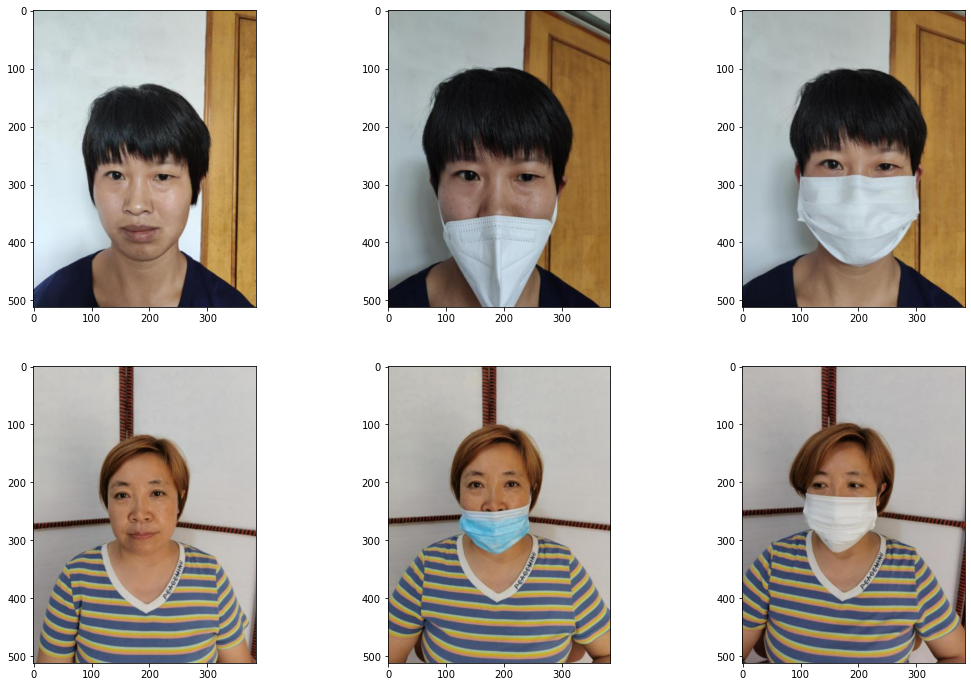

In [119]:
trans2 = A_transforms.CLAHE(clip_limit = (4, 4), p = 0)
transformed2_img1 = trans2(image = image1)['image']
transformed2_img2 = trans2(image = image2)['image']
transformed2_img3 = trans2(image = image3)['image']
transformed2_img4 = trans2(image = image4)['image']
transformed2_img5 = trans2(image = image5)['image']
transformed2_img6 = trans2(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed2_img1)
axes[0][1].imshow(transformed2_img2)
axes[0][2].imshow(transformed2_img3)

axes[1][0].imshow(transformed2_img4)
axes[1][1].imshow(transformed2_img5)
axes[1][2].imshow(transformed2_img6)
plt.show()

#### 1. 기본값
- clip_limit = 4

In [12]:
img_path1 = os.path.join(root_path,age2_df['path'][0])
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

img_path2 = os.path.join(root_path,age2_df['path'][1])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

img_path3 = os.path.join(root_path,age2_df['path'][2])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

img_path4 = os.path.join(root_path,age1_df['path'][0])
image4 = cv2.imread(img_path4)
image4 = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)

img_path5 = os.path.join(root_path,age1_df['path'][1])
image5 = cv2.imread(img_path5)
image5 = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)

img_path6 = os.path.join(root_path,age1_df['path'][2])
image6 = cv2.imread(img_path6)
image6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

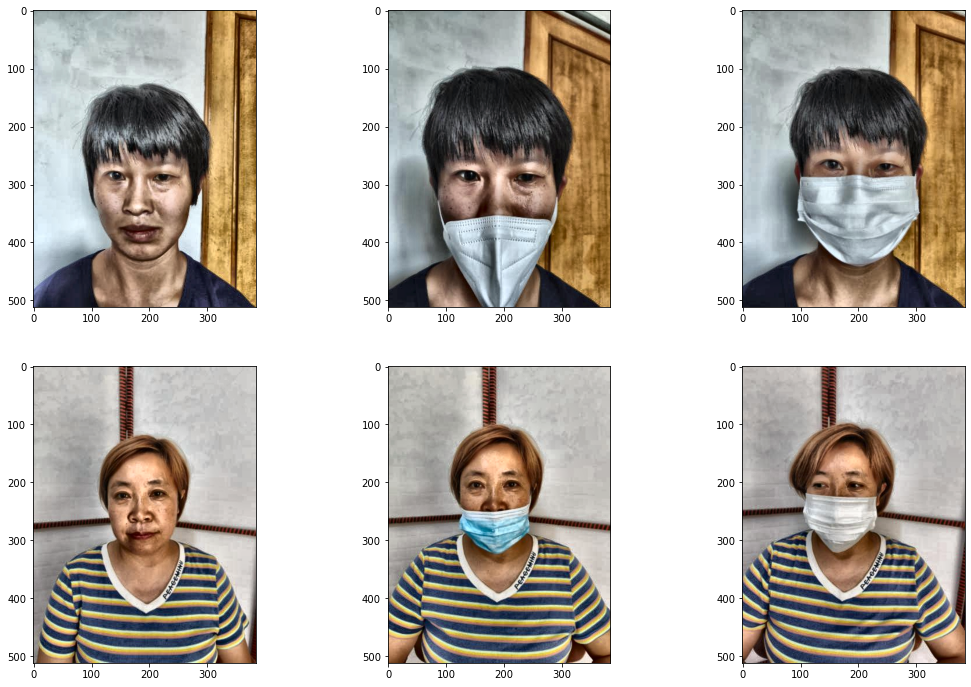

In [117]:
trans2 = A_transforms.CLAHE(clip_limit = (4, 4), p = 1)
transformed2_img1 = trans2(image = image1)['image']
transformed2_img2 = trans2(image = image2)['image']
transformed2_img3 = trans2(image = image3)['image']
transformed2_img4 = trans2(image = image4)['image']
transformed2_img5 = trans2(image = image5)['image']
transformed2_img6 = trans2(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed2_img1)
axes[0][1].imshow(transformed2_img2)
axes[0][2].imshow(transformed2_img3)

axes[1][0].imshow(transformed2_img4)
axes[1][1].imshow(transformed2_img5)
axes[1][2].imshow(transformed2_img6)
plt.show()

#### clip_limit : 10

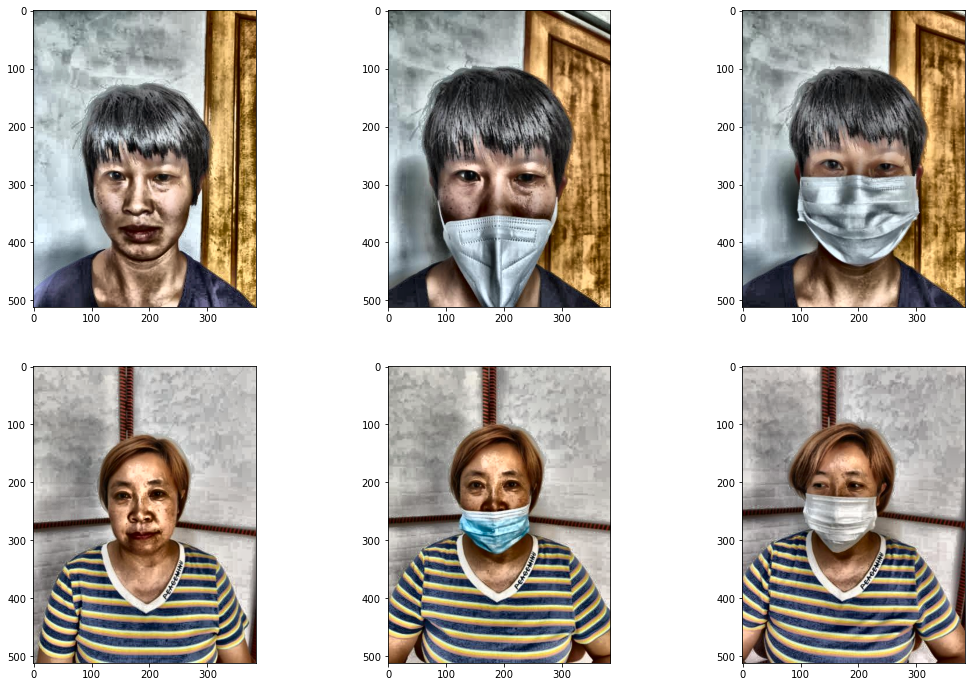

In [118]:
trans2 = A_transforms.CLAHE(clip_limit = (10, 10), p = 1)
transformed2_img1 = trans2(image = image1)['image']
transformed2_img2 = trans2(image = image2)['image']
transformed2_img3 = trans2(image = image3)['image']
transformed2_img4 = trans2(image = image4)['image']
transformed2_img5 = trans2(image = image5)['image']
transformed2_img6 = trans2(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed2_img1)
axes[0][1].imshow(transformed2_img2)
axes[0][2].imshow(transformed2_img3)

axes[1][0].imshow(transformed2_img4)
axes[1][1].imshow(transformed2_img5)
axes[1][2].imshow(transformed2_img6)
plt.show()

- 20대가 20대처럼 보이지 않아서 다른 데이터로 다시 확인

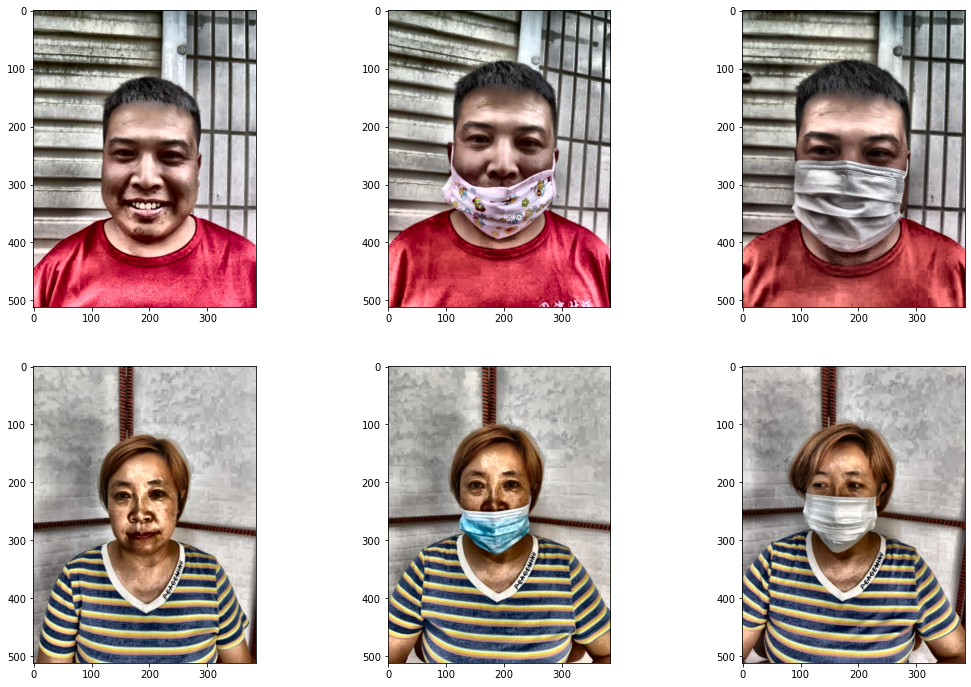

In [121]:
img_path1 = os.path.join(root_path,age0_df['path'][7])
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

img_path2 = os.path.join(root_path,age0_df['path'][8])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

img_path3 = os.path.join(root_path,age0_df['path'][9])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

img_path4 = os.path.join(root_path,age1_df['path'][0])
image4 = cv2.imread(img_path4)
image4 = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)

img_path5 = os.path.join(root_path,age1_df['path'][1])
image5 = cv2.imread(img_path5)
image5 = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)

img_path6 = os.path.join(root_path,age1_df['path'][2])
image6 = cv2.imread(img_path6)
image6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

trans2 = A_transforms.CLAHE(clip_limit = (10, 10), p = 1)
transformed2_img1 = trans2(image = image1)['image']
transformed2_img2 = trans2(image = image2)['image']
transformed2_img3 = trans2(image = image3)['image']
transformed2_img4 = trans2(image = image4)['image']
transformed2_img5 = trans2(image = image5)['image']
transformed2_img6 = trans2(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed2_img1)
axes[0][1].imshow(transformed2_img2)
axes[0][2].imshow(transformed2_img3)

axes[1][0].imshow(transformed2_img4)
axes[1][1].imshow(transformed2_img5)
axes[1][2].imshow(transformed2_img6)
plt.show()

- 전체적인 느낌은 나이들게 보이게 해서 연령대를 구분하기는 어려워 보임
- 피부 상태나 주름을 강조하는 느낌이지만 연령대를 구분하는 Feature를 얼굴 피부나 주름 상태를 본다면 분명 주요한 요소가 될 수 있음

### 3. ChannelShuffle

- channel에 따른 각각의 특징이 있기 때문에 shuffle을 통해 구분이 더 쉽게 되는 요소들이 있을 것이라 판단

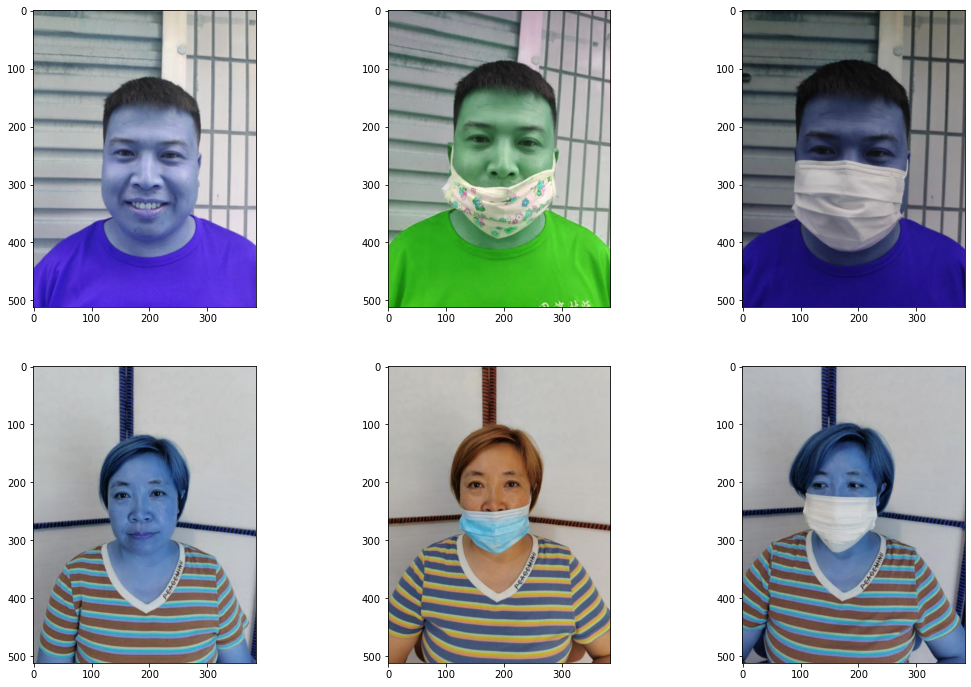

In [122]:
img_path1 = os.path.join(root_path,age0_df['path'][7])
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

img_path2 = os.path.join(root_path,age0_df['path'][8])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

img_path3 = os.path.join(root_path,age0_df['path'][9])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

img_path4 = os.path.join(root_path,age1_df['path'][0])
image4 = cv2.imread(img_path4)
image4 = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)

img_path5 = os.path.join(root_path,age1_df['path'][1])
image5 = cv2.imread(img_path5)
image5 = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)

img_path6 = os.path.join(root_path,age1_df['path'][2])
image6 = cv2.imread(img_path6)
image6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

trans3 = A_transforms.ChannelShuffle(p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

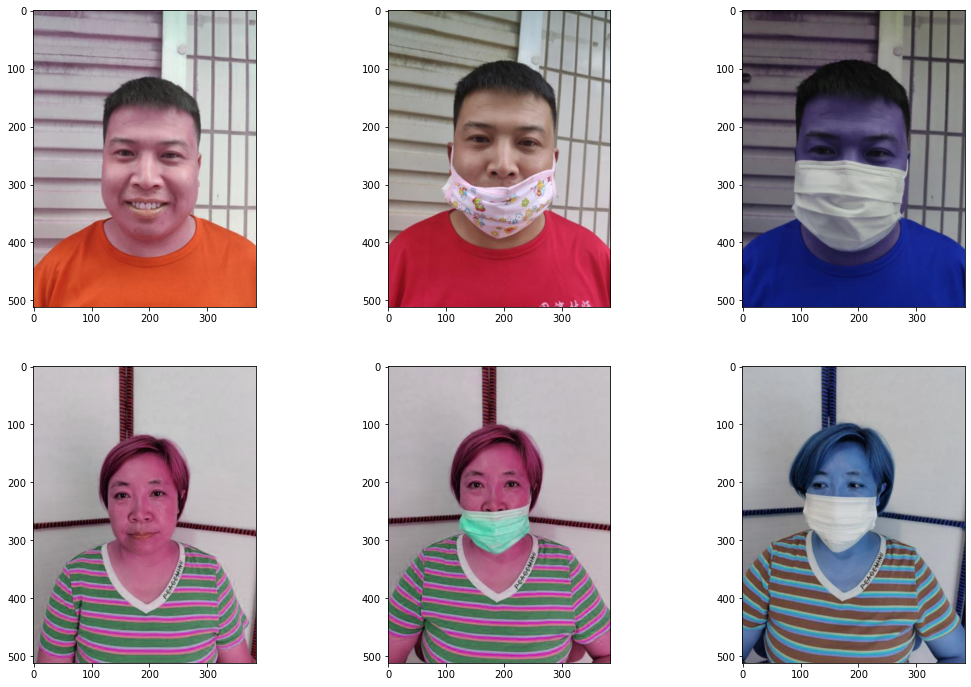

In [123]:
img_path1 = os.path.join(root_path,age0_df['path'][7])
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

img_path2 = os.path.join(root_path,age0_df['path'][8])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

img_path3 = os.path.join(root_path,age0_df['path'][9])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

img_path4 = os.path.join(root_path,age1_df['path'][0])
image4 = cv2.imread(img_path4)
image4 = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)

img_path5 = os.path.join(root_path,age1_df['path'][1])
image5 = cv2.imread(img_path5)
image5 = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)

img_path6 = os.path.join(root_path,age1_df['path'][2])
image6 = cv2.imread(img_path6)
image6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

trans3 = A_transforms.ChannelShuffle(p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 흰색마스크의 경우 굉장히 잘잡을 것이라 판단됨
- RGB shuffle 효과로 인하여 마스크와 피부간의 색상 차이가 생기는 효과와 함께 다양한 마스크 색을 학습시킬 수 있는 장점이 있음
- 배경색, 옷색깔에 영향을 덜 받을 가능성이 높음

### 4. RGB Shift
- Channel shuffle과 다르게 채널별로 색상을 조절하면서 변화시킬 수 있음

#### 1. R 채널 변경
- 기본값 : 20 (랜덤 X)

In [21]:
img_path1 = os.path.join(root_path,age0_df['path'][7])
image1 = cv2.imread(img_path1)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

img_path2 = os.path.join(root_path,age0_df['path'][8])
image2 = cv2.imread(img_path2)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

img_path3 = os.path.join(root_path,age0_df['path'][9])
image3 = cv2.imread(img_path3)
image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)

img_path4 = os.path.join(root_path,age1_df['path'][0])
image4 = cv2.imread(img_path4)
image4 = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)

img_path5 = os.path.join(root_path,age1_df['path'][1])
image5 = cv2.imread(img_path5)
image5 = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)

img_path6 = os.path.join(root_path,age1_df['path'][2])
image6 = cv2.imread(img_path6)
image6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

trans3 = A_transforms.RGBShift(r_shift_limit=(20, 20), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

NameError: name 'root_path' is not defined

#### r_channel : -20

In [7]:
trans3 = A_transforms.RGBShift(r_shift_limit=(-20, -20), p = 1, g_shift_limit = (0, 0), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

NameError: name 'image1' is not defined

#### r_channel : 60

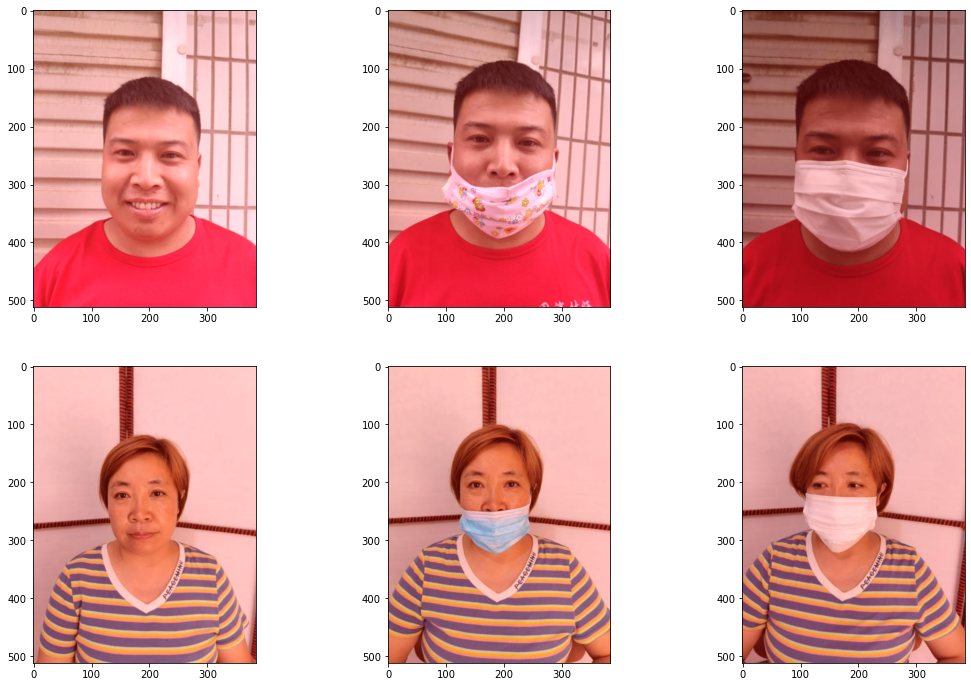

In [131]:
trans3 = A_transforms.RGBShift(r_shift_limit=(60, 60), p = 1, g_shift_limit = (0, 0), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel : 60

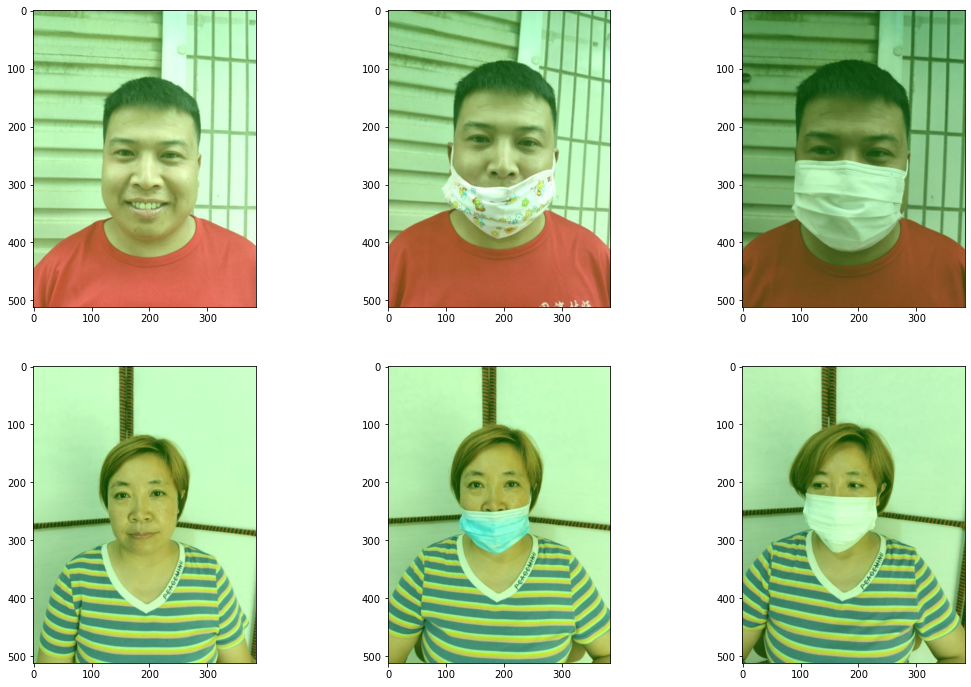

In [132]:
trans3 = A_transforms.RGBShift(g_shift_limit=(60, 60), p = 1, r_shift_limit = (0, 0), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel : -60

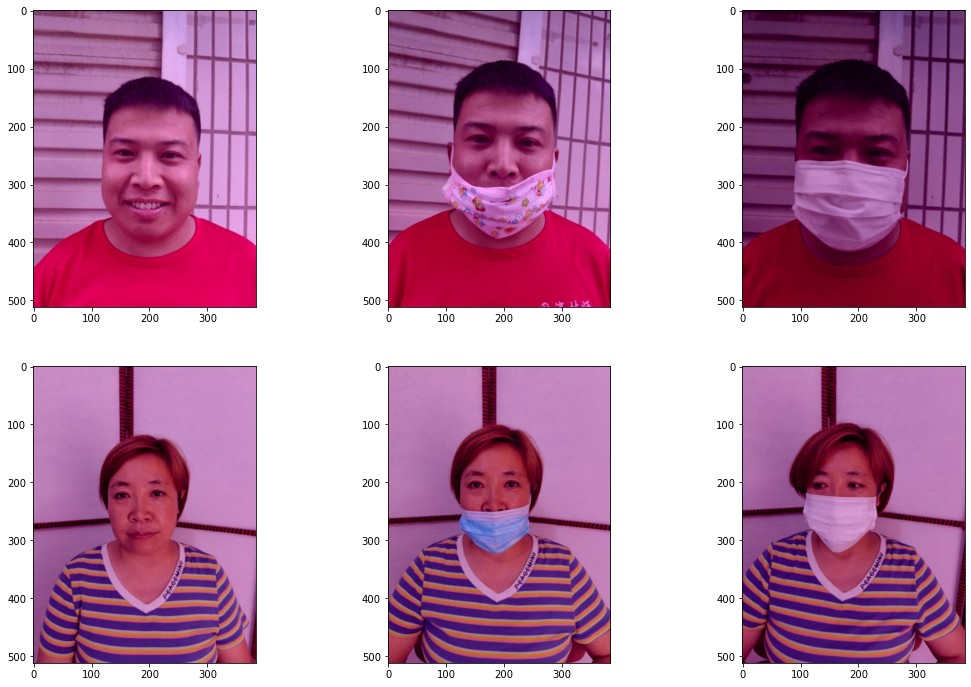

In [133]:
trans3 = A_transforms.RGBShift(g_shift_limit=(-60, -60), p = 1, r_shift_limit = (0, 0), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel : 150

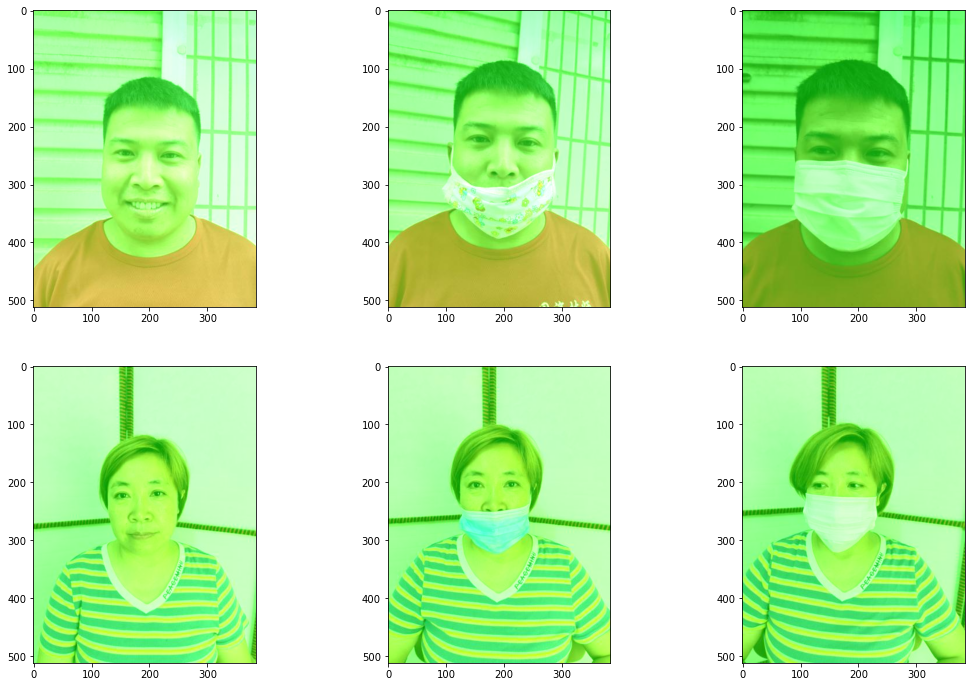

In [135]:
trans3 = A_transforms.RGBShift(g_shift_limit=(150, 150), p = 1, r_shift_limit = (0, 0), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel : 150, r_channel : 150

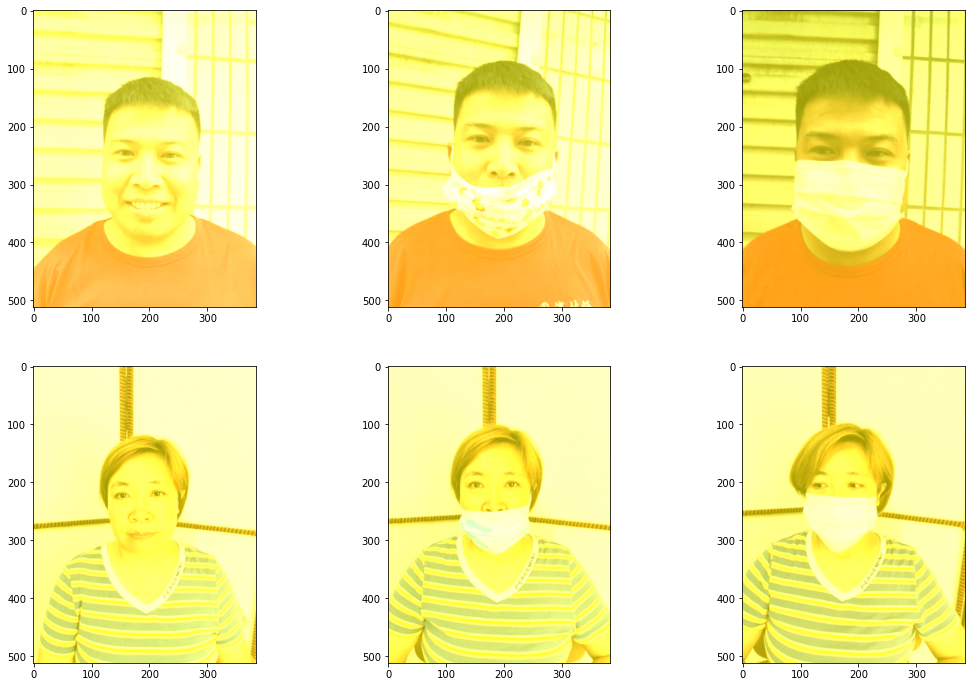

In [136]:
trans3 = A_transforms.RGBShift(g_shift_limit=(150, 150), p = 1, r_shift_limit = (150, 150), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel : -150, r_channel : -150

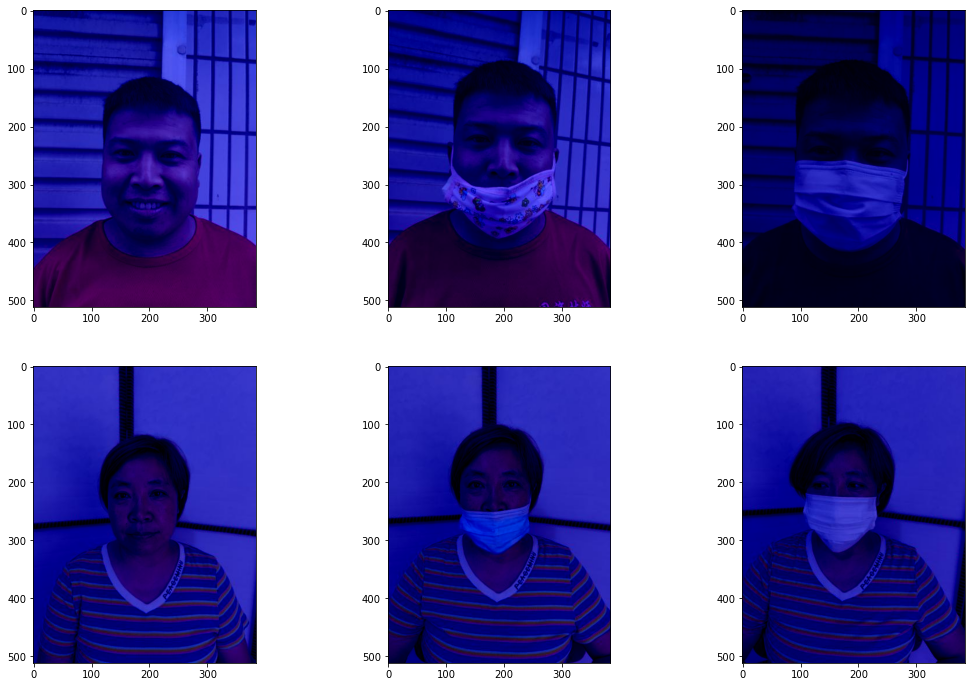

In [137]:
trans3 = A_transforms.RGBShift(g_shift_limit=(-150, -150), p = 1, r_shift_limit = (-150, -150), b_shift_limit = (0, 0))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### r_channel , b_channel : -150

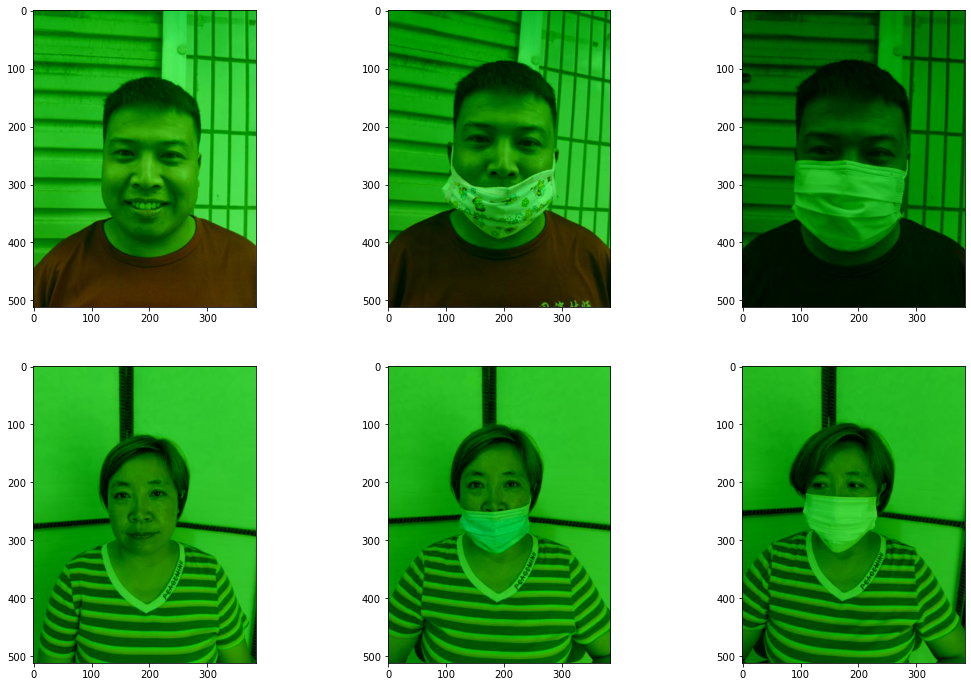

In [138]:
trans3 = A_transforms.RGBShift(g_shift_limit=(0, 0), p = 1, r_shift_limit = (-150, -150), b_shift_limit = (-150, -150))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

#### g_channel , b_channel : -150

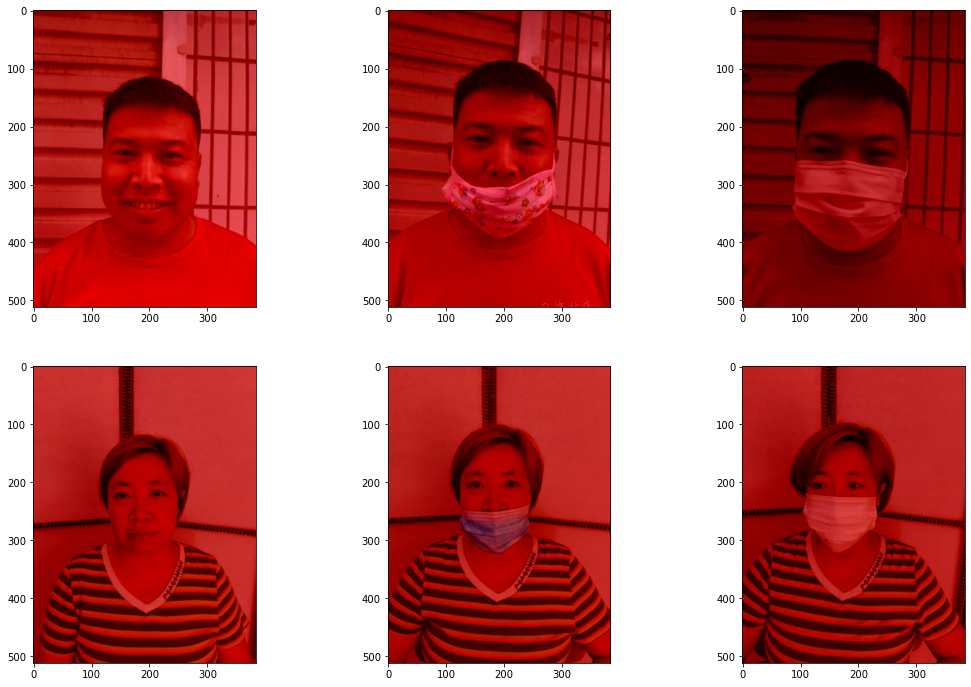

In [139]:
trans3 = A_transforms.RGBShift(g_shift_limit=(-150, -150), p = 1, r_shift_limit = (0, 0), b_shift_limit = (-150, -150))
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 연령대나 성별을 구분하는데 큰 영향을 끼치기는 어려운 요소
- 하지만 같은 공간에서 찍는 사진들도 있고, 같은 사람이 같은 위치에서 찍기 때문에 이런 rgb shift를 통해 배경, 공간이 마스크에 집중할 수 있는 효과가 있음
- 범위를 -150 ~ 150 으로 두면 좋을 것 같음!
- 하지만 뒤에 나오는 ChannelDropout으로 충분히 효과를 얻을 수 있어서 추가로 넣을 필요는 없다고 판단됨

#### 5. RandomBrightnessContrast
- RGB shift와 비슷한 효과를 기대

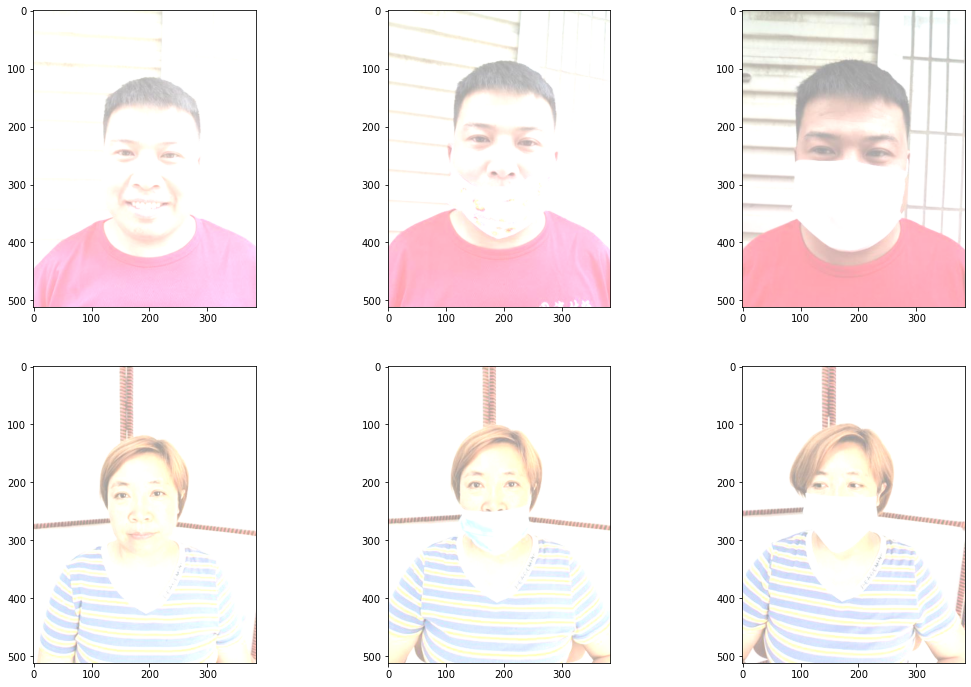

In [146]:
trans3 = A_transforms.RandomBrightnessContrast(brightness_limit=(0.6, 0.6), contrast_limit=(0, 0), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- Brightness 는 너무 밝으면 마스크와 구별이 어려워 만약 age 요소로 얼굴의 피부 요소를 선택한다면 무조건 젊게 나올 가능성이 높으므로 좋은 효과는 아님
- 마스크 착용관점에서는 코의 가림 상태나 턱의 가림상태를 구분하기 좋아 보임

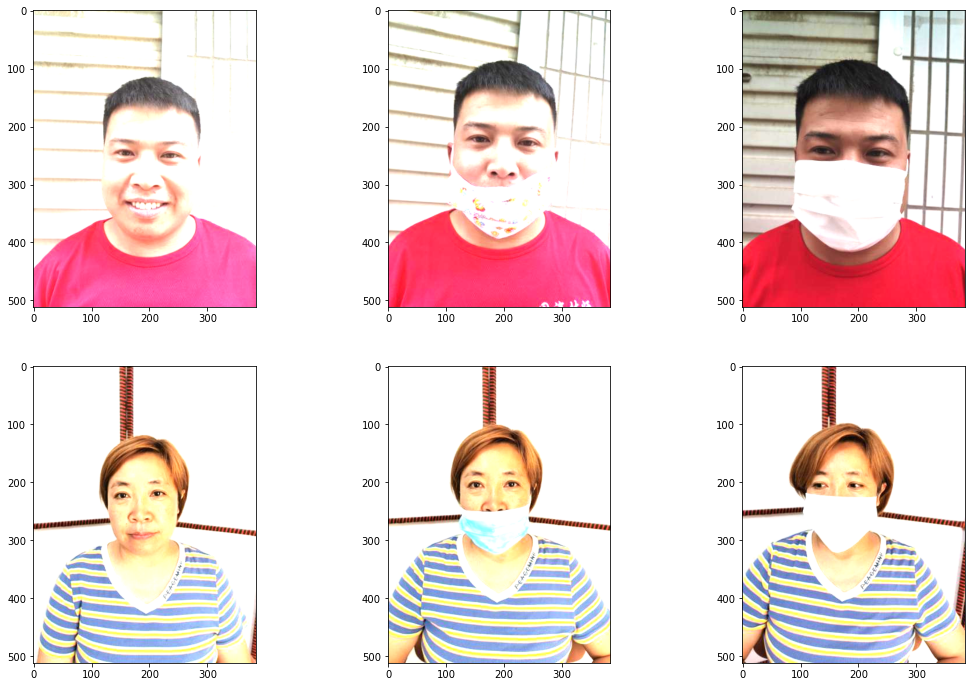

In [144]:
trans3 = A_transforms.RandomBrightnessContrast(brightness_limit=(0, 0), contrast_limit=(1, 1), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 뒷배경을 모두 밝게하는 효과가 있어서 얼굴과 옷에 집중하게 해줄 수 있음
- Brightness 와 적절하게 섞는다면??

#### 1. brightness = 0.4, contrast = 1

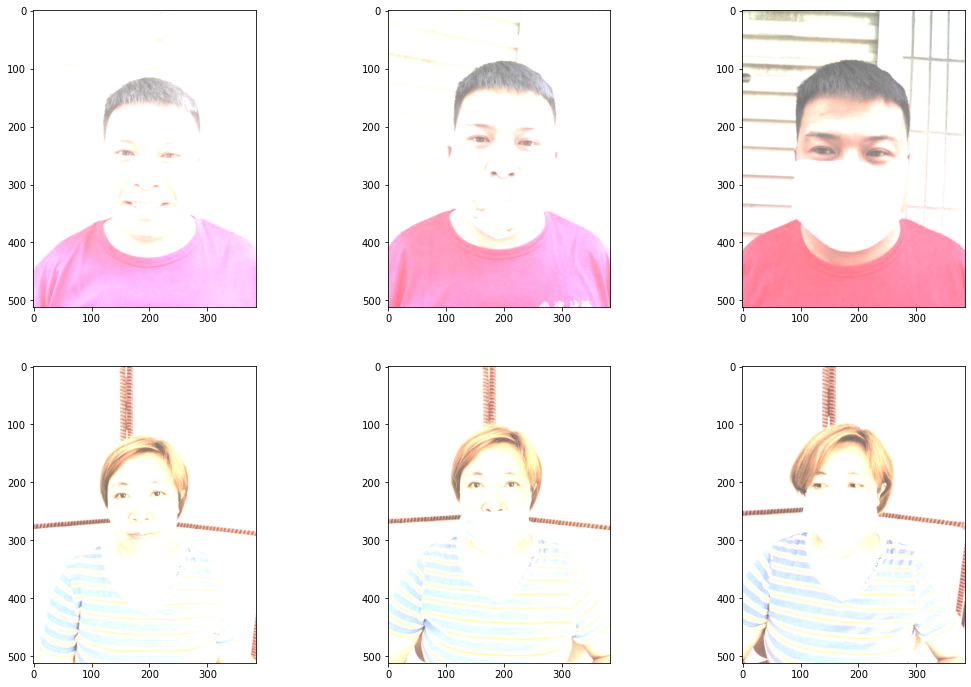

In [155]:
trans3 = A_transforms.RandomBrightnessContrast(brightness_limit=(0.4, 0.4), contrast_limit=(1, 1), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 밝기와 Contrast를 적절히 섞은 결과 콧구멍과 입을 강조해서 Mask 착용여부를 체크할 수 있을 거라 판단됨
- age나 성별 구분은 어려워보임

#### 2. brightness = 0.4 Contrast = -1

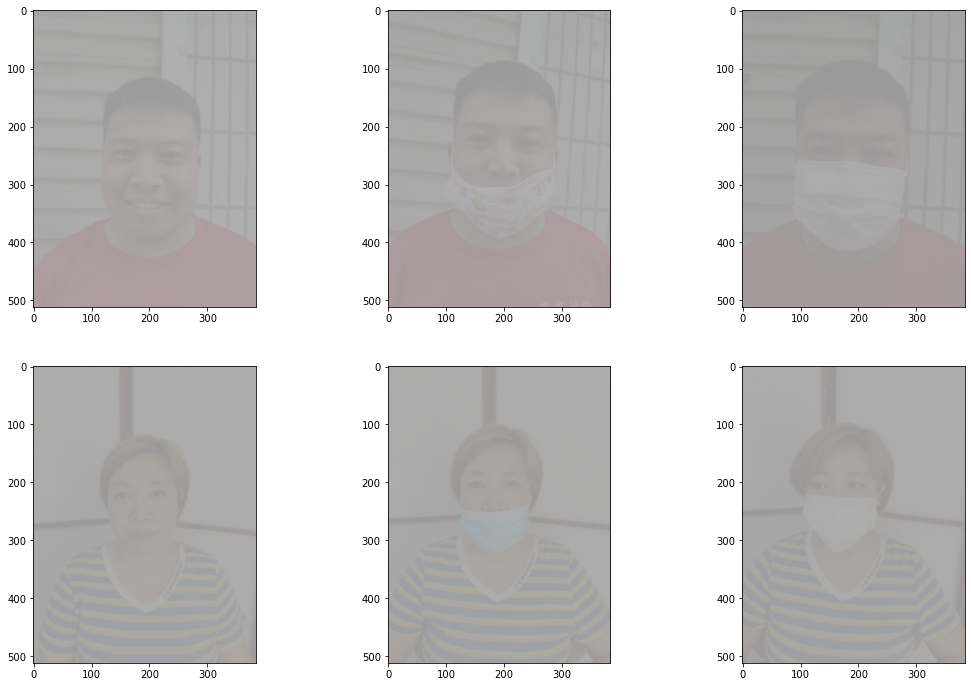

In [158]:
trans3 = A_transforms.RandomBrightnessContrast(brightness_limit=(0.6, 0.6), contrast_limit=(-0.9, -0.9), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 선명도 자체가 떨어져서 Noise나 다른 효과 대비 좋아보이지는 않음
- Contrast는 +1에 Brightness는 0.4~0.6 정도의 효과를 랜덤으로 주면 마스크 착용 여부를 관찰하기 좋아보임

### 7. ToGray
- 흑백 처리해서 색상에 영향을 덜 받아서 전체적으로 좋은 영향을 끼칠 것이라 판단됨
- 피부, 주름 상태 등 CLAHE와 좋은 시너지가 나올거라 예상됨

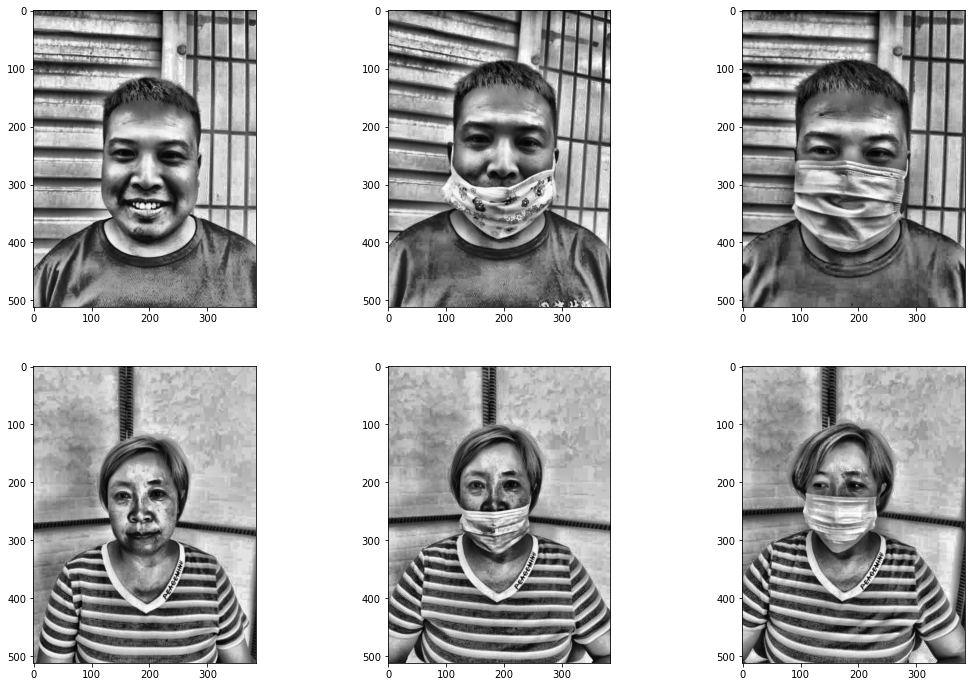

In [159]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1), A_transforms.ToGray(p = 1)]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 예상보다 더 좋게 나타났고, 피부 상태, 주름의 상태를 확인할 수 있으며 머리 색이나 옷, 배경 색에 큰 영향을 받지 않게 될 수 있음
- Contrast 와 합친다면?

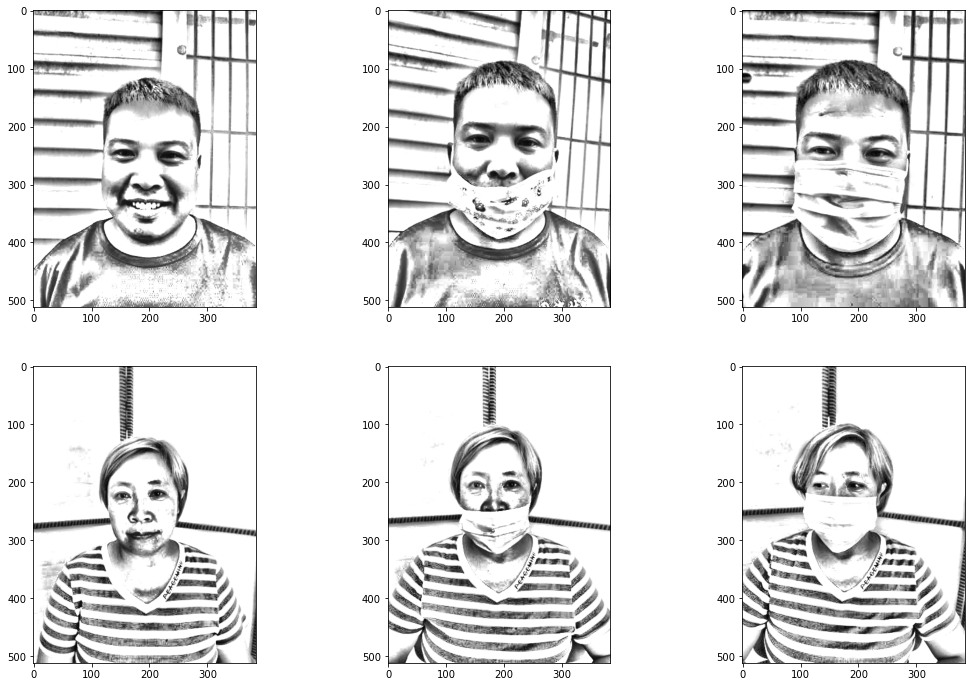

In [164]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1), A_transforms.ToGray(p = 1), A_transforms.RandomBrightnessContrast(brightness_limit=(0, 0), contrast_limit=(1, 1), p = 1)]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 예상대로 불필요한 색상들이 없어지고 얼굴의 윤곽과 피부상태 등만 강조되고 있다.
- Brightness 까지 넣어보자

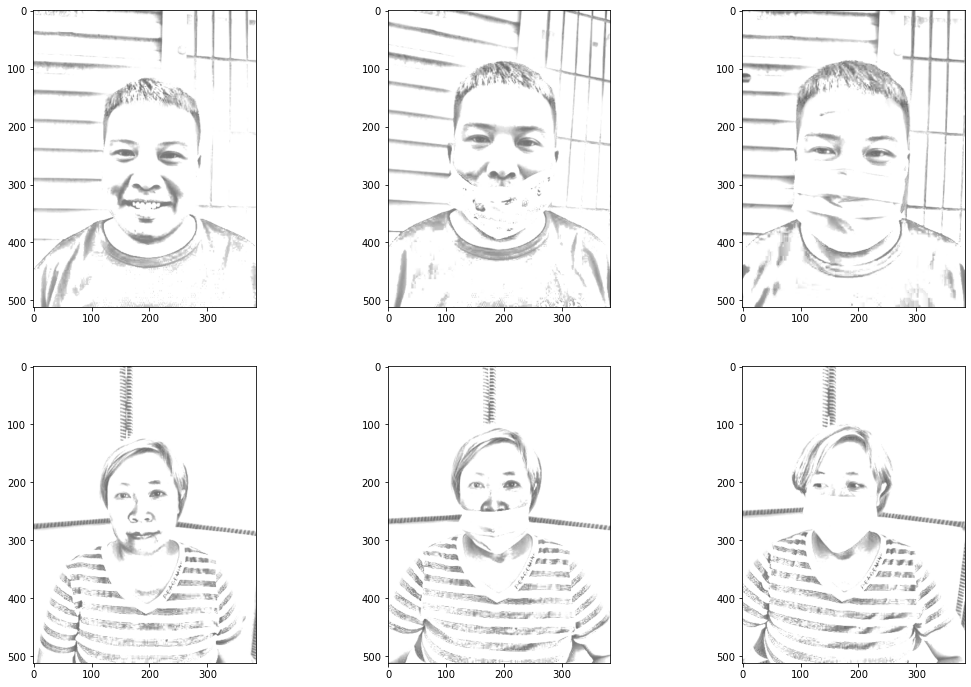

In [165]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1), A_transforms.ToGray(p = 1), A_transforms.RandomBrightnessContrast(brightness_limit=(0.4, 0.4), contrast_limit=(1, 1), p = 1)]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 피부상태를 확인하기는 조금 어려우나 눈 코 입 feature를 명확하게 확인할 수 있고, 머리형태 등을 확인하는데는 큰 문제는 없어보임
- 너무 밝지않게 준다면 좋은 효과가 있을 것 같음
- 만약 -값을 주면?

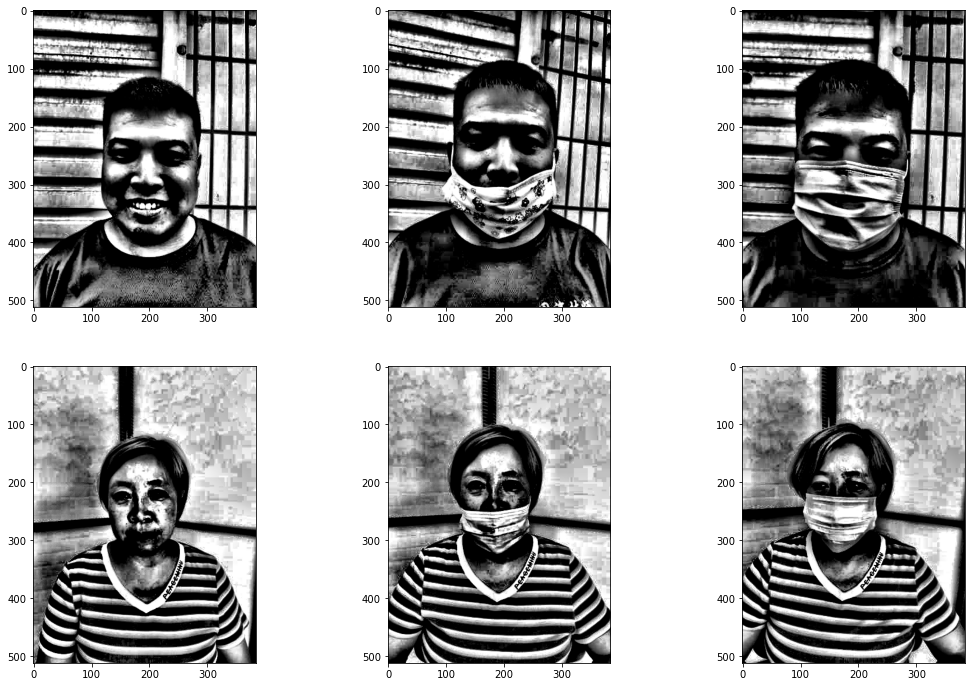

In [167]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1), A_transforms.ToGray(p = 1), A_transforms.RandomBrightnessContrast(brightness_limit=(-0.7, -0.7), contrast_limit=(1, 1), p = 1)]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 피부상태를 좀 더 확인하기 좋아 보이며 마스크 착용여부에 대해서도 큰 문제 없이 확인 가능함, 성별도 머리의 길이 등을 통해 구분하기 좋아 보임
- -0.5 ~ 0.5 사이로 랜덤하게 주면 좋을 것 같음!

### 8. ColorJitter
- brightness, contrast, saturation 효과를 동시에 줌
- BrightnessContrast 보다 더 좋은 효과를 기대할 수 있을지 의문?

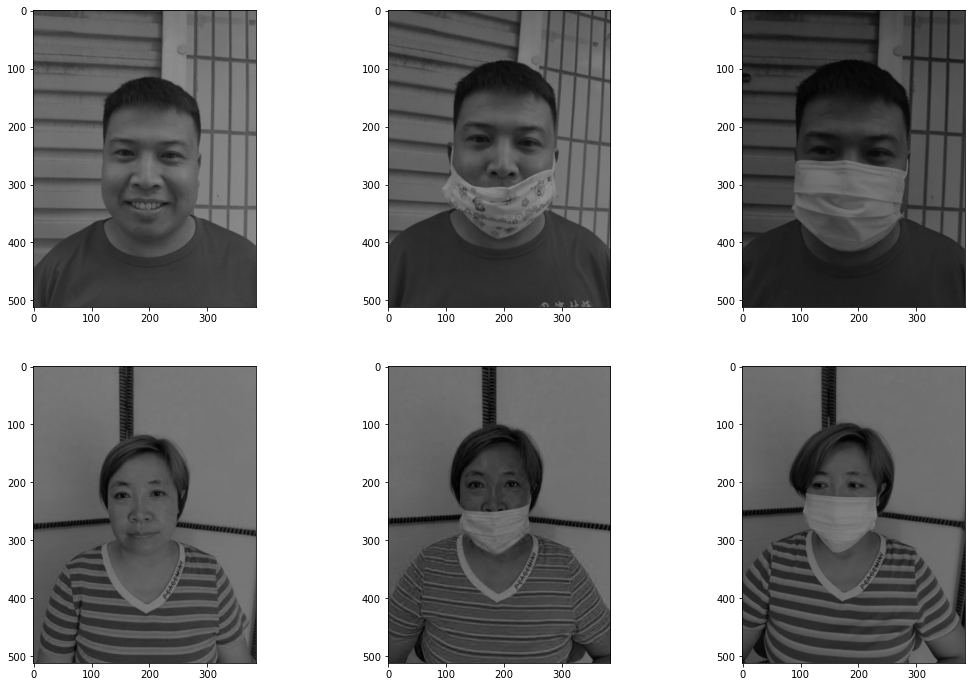

In [186]:
trans3 = A_transforms.ColorJitter(brightness=(0.6, 0.6), contrast=(1, 1), saturation=(0, 0), p = 1, hue = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- Saturation 채도를 낮추는 효과로 보임
- 오히려 hue값을 주어서 Channel Shuffle 을 같이줄 수 있는 장점이 있음
- 다른 augmentation 대비 장점은 잘 보이지 않음

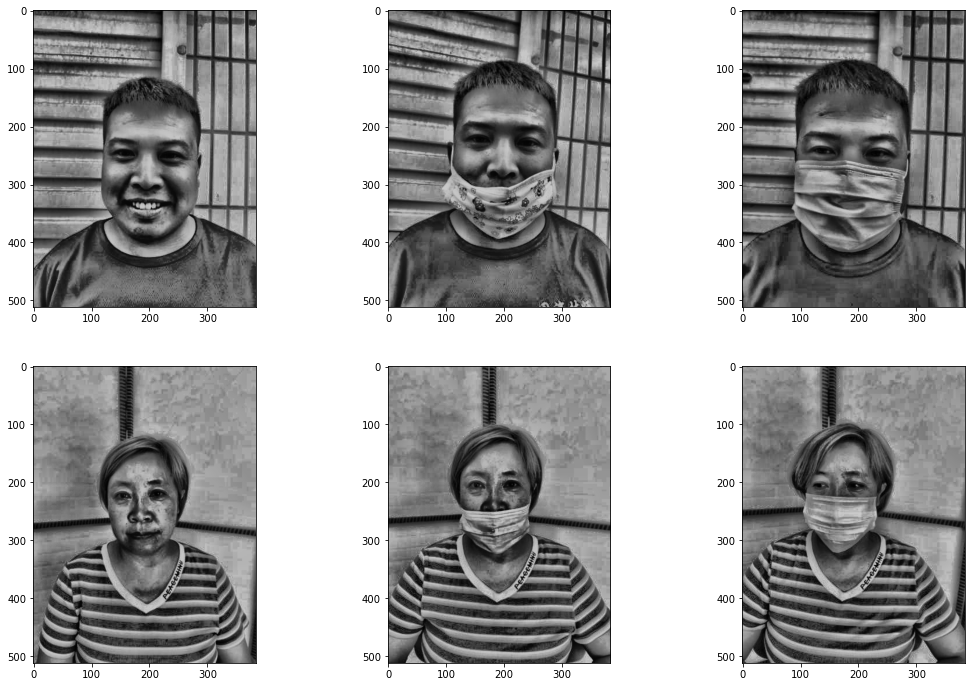

In [189]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10),
                                       tile_grid_size = (10, 10), p = 1),
                    A_transforms.ToGray(p = 1),
                    A_transforms.ColorJitter(brightness=(0.8, 0.8), contrast=(1, 1), saturation=(1, 1), p = 1, hue = 1)
                   ]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 특별히 다른 Contrast, Brightness와 비교하면 장점은 없어보임

#### 9. Flip
- Horizontal 의 좌우반전효과를 통해 데이터를 늘리는 효과는 기대할 수 있음

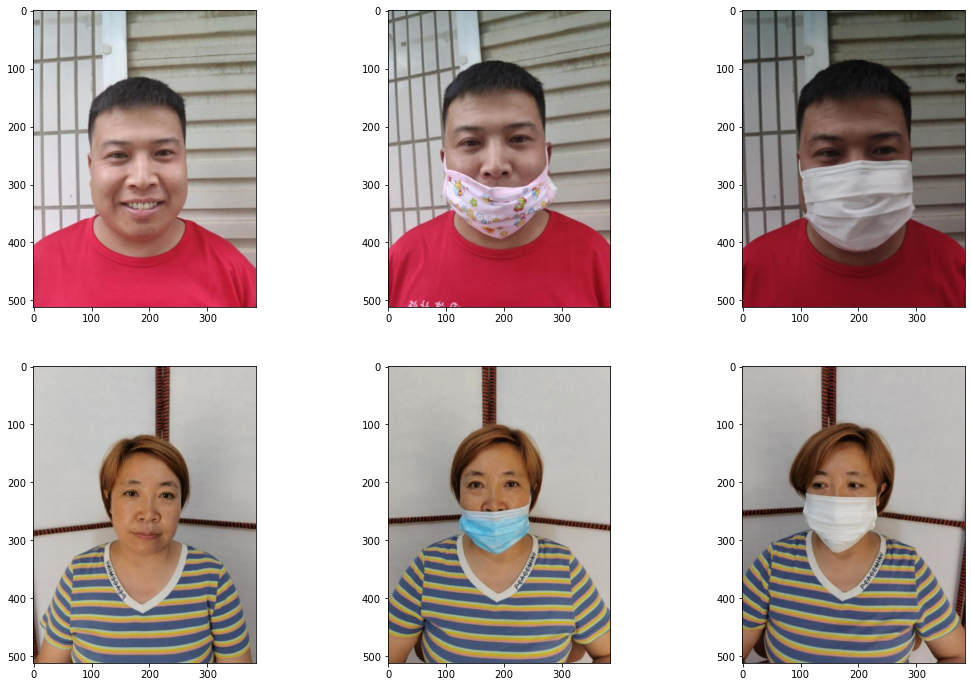

In [191]:
trans3 = A_transforms.HorizontalFlip(p = 0.5)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 옷을 보면 확률적으로 변경된 것을 알 수 있음
- 가르마 등의 영향을 받지 않는 효과도 기대할 수 있음

### 10. GaussNoise
- 가우시안 노이즈효과를 줌
- 적절한 비율로 주면 오히려 성능 향상에 효과가 좋다는 이야기가 있음
- Generalization 관점에서 좋게 작용할 가능성이 있음

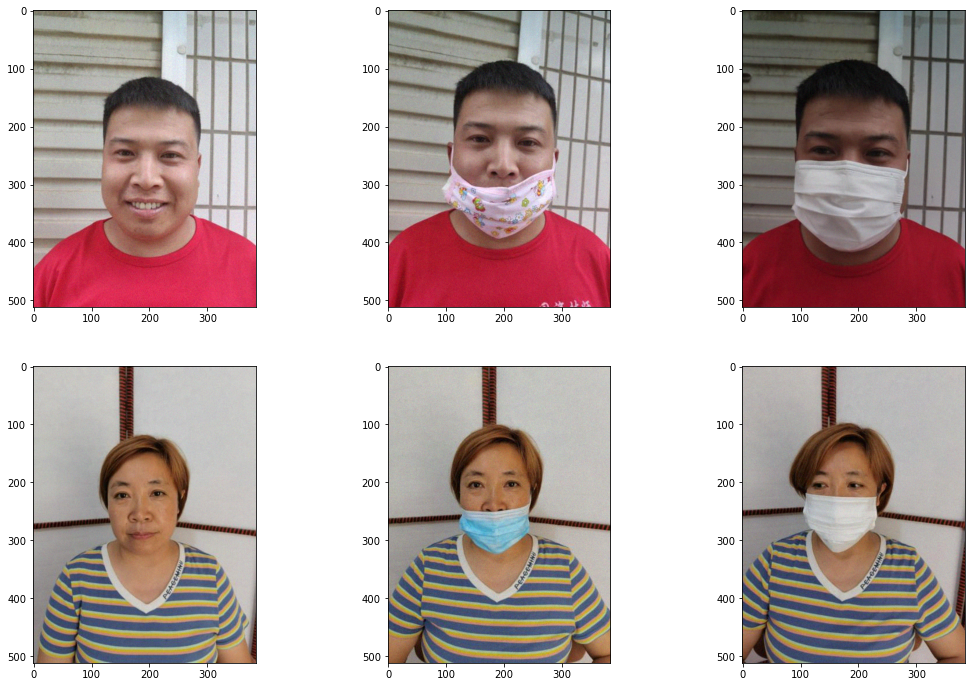

In [221]:

trans3 = A_transforms.GaussNoise( mean = 0, var_limit = (10, 50), p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

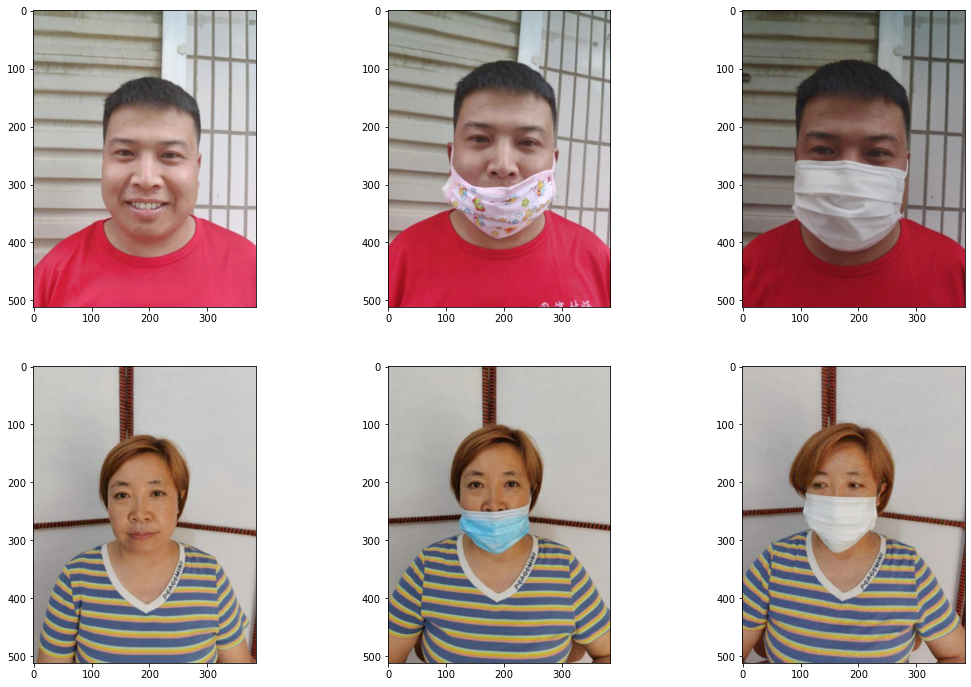

In [223]:
trans3 = A_transforms.ISONoise(p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

### 11. TemplateTransform
- 다른 사람의 이미지를 겹치게 해서
- Generalization 효과를 주는 것
    - 확률적으로 가중치가 높은 것을 라벨로 주게 되어 Mix되게 하면 효과가 있을 것으로 보임
- 다른 일반 이미지는 Noise 주는 것과 다를게 없어보임

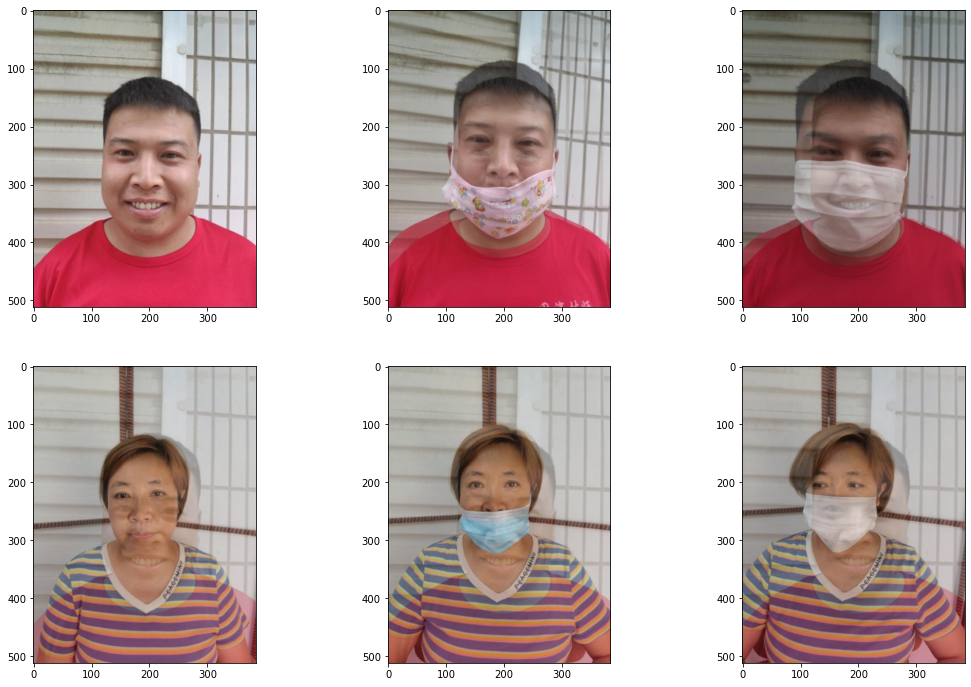

In [198]:
trans3 = A_transforms.TemplateTransform(templates = transformed3_img1, img_weight = 0.7, template_weight = 0.3, p = 1)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

### 12. CoarseDropout
- 랜덤하게 구멍을 내는 방법
- 데이터를 늘리는 효과는 기대해 볼 수 있음

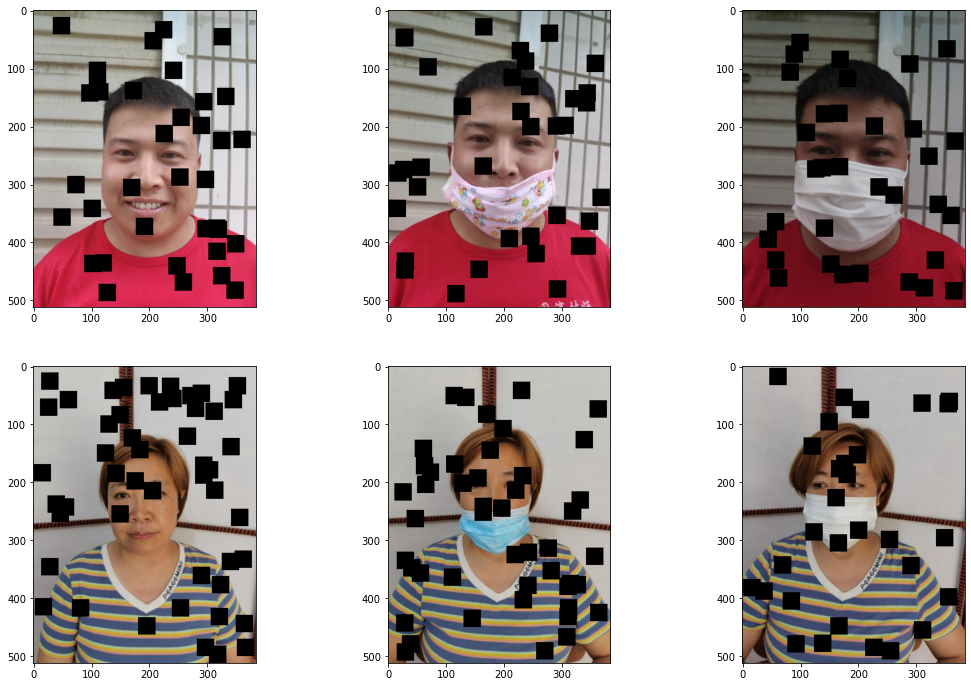

In [282]:
trans3 = A_transforms.CoarseDropout(min_holes = 30, max_holes = 50, p = 1, fill_value = 0, max_height = 30, min_height = 30, min_width = 30, max_width = 30)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 너무 많이 하지만 않는다면 데이터를 늘리기 좋은 augmentation
- 위의 결과는 나름 적절해 보이는 수치를 찾았음

### 13. ChannelDropout
- 의도적으로 channel 을 없애는 효과
- 기존 heatmap에서 확인했을 때 좋은 효과를 보일 수 있다고 봄

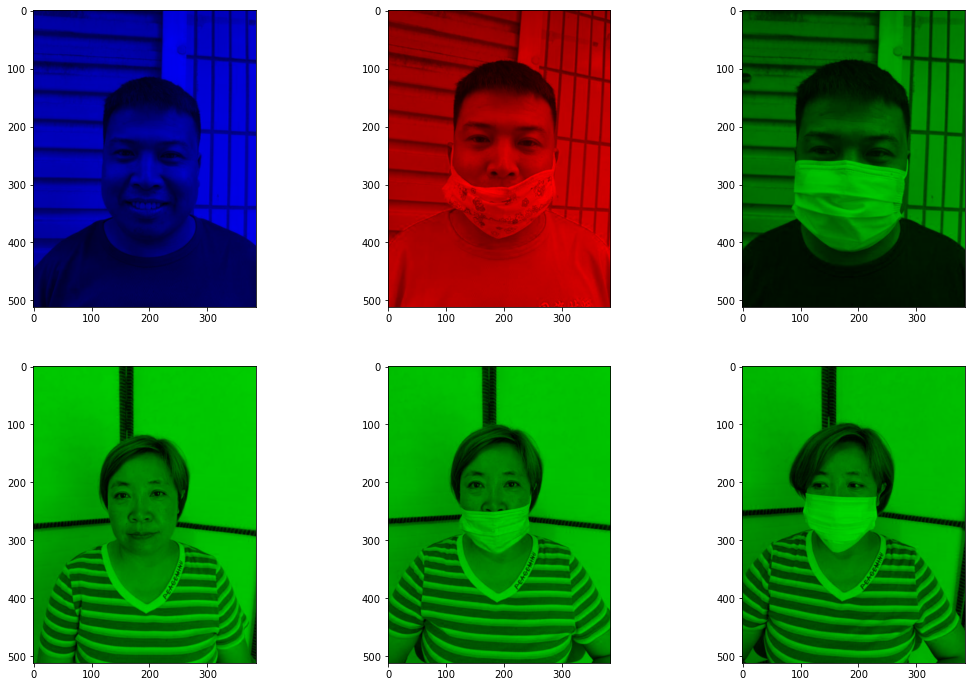

In [217]:
trans3 = A_transforms.ChannelDropout(channel_drop_range=(2, 2), p = 1, fill_value = 0)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

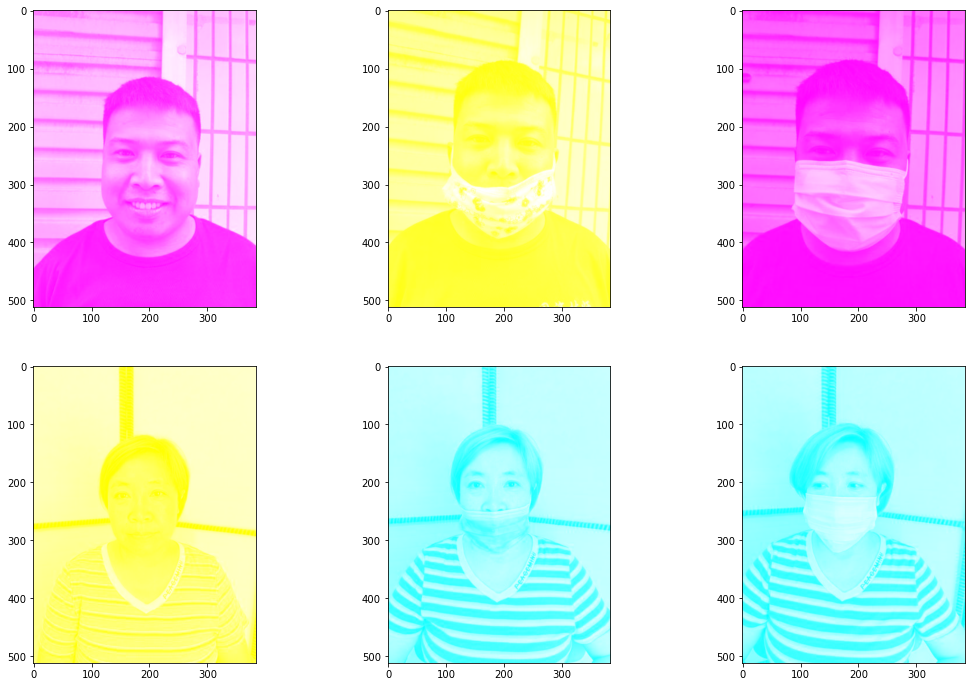

In [238]:
trans3 = A_transforms.ChannelDropout(channel_drop_range=(2, 2), p = 1, fill_value = 255)
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- RGB Shift, Channel shuffle 보다 더 좋다고 생각됨
- 다른 것과 섞어서 사용하면??

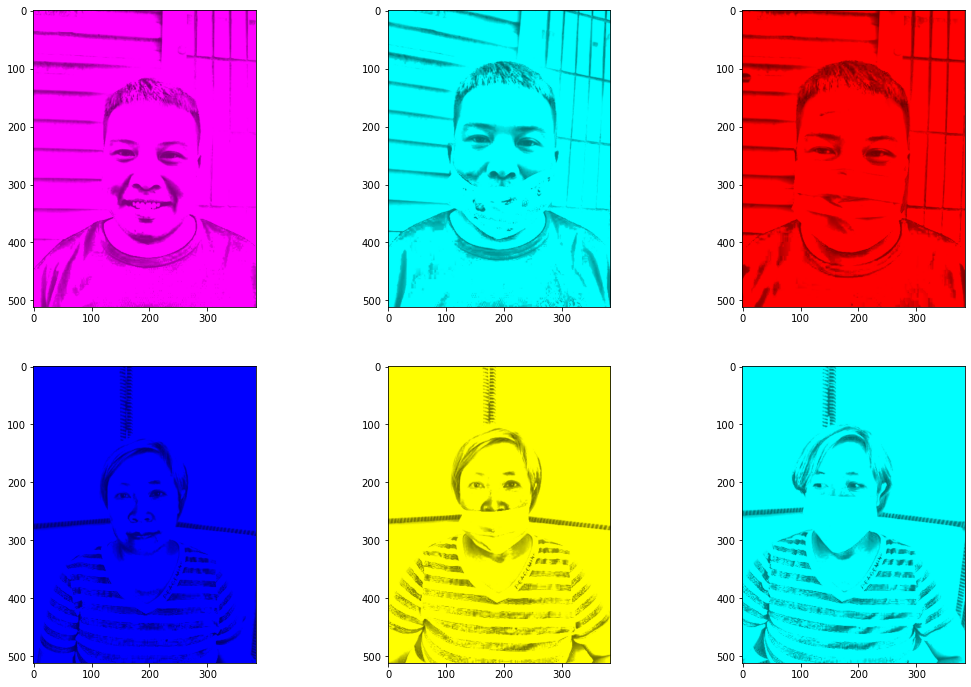

In [220]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1),
                    A_transforms.ToGray(p = 1),
                    A_transforms.RandomBrightnessContrast(brightness_limit=(0.4, 0.4), contrast_limit=(1, 1), p = 1),
                    A_transforms.ChannelDropout(channel_drop_range=(1, 2), p = 1, fill_value = 0)
                   ]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- feature를 추출하는데 큰 문제는 없어 보임!
- fill_value = 255 로 하면?

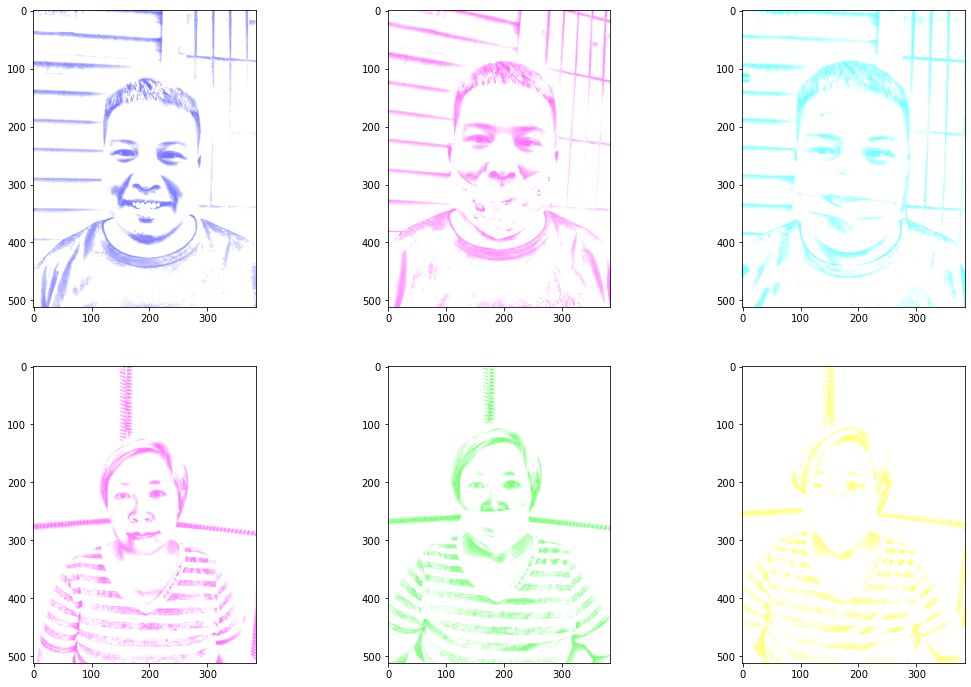

In [224]:
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1),
                    A_transforms.ToGray(p = 1),
                    A_transforms.RandomBrightnessContrast(brightness_limit=(0.4, 0.4), contrast_limit=(1, 1), p = 1),
                    A_transforms.ChannelDropout(channel_drop_range=(1, 2), p = 1, fill_value = 255)
                   ]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

- 개인적으로는 255가 더 좋아보이지만 fill_value 를 0 255 랜덤으로 주면 더 좋을 수도

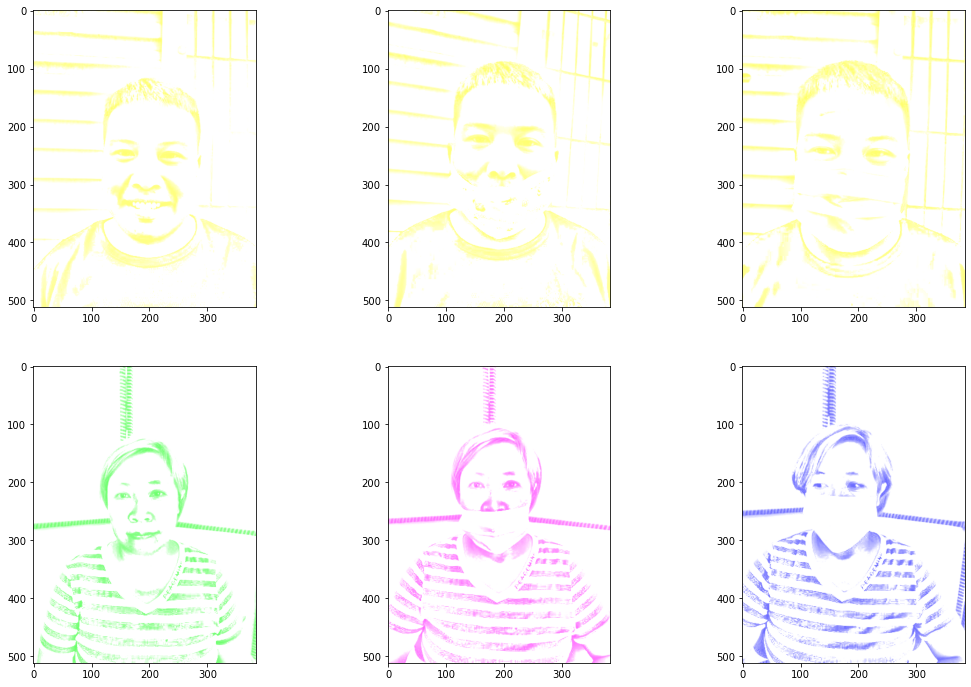

In [237]:
fill_value_list = [0, 255]
trans3 = A.Compose([A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1),
                    A_transforms.ToGray(p = 1),
                    A_transforms.RandomBrightnessContrast(brightness_limit=(0.4, 0.4), contrast_limit=(1, 1), p = 1),
                    A_transforms.ChannelDropout(channel_drop_range=(1, 2), p = 1, fill_value = fill_value_list[np.random.randint(low = 0, high = 2)])
                   ]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

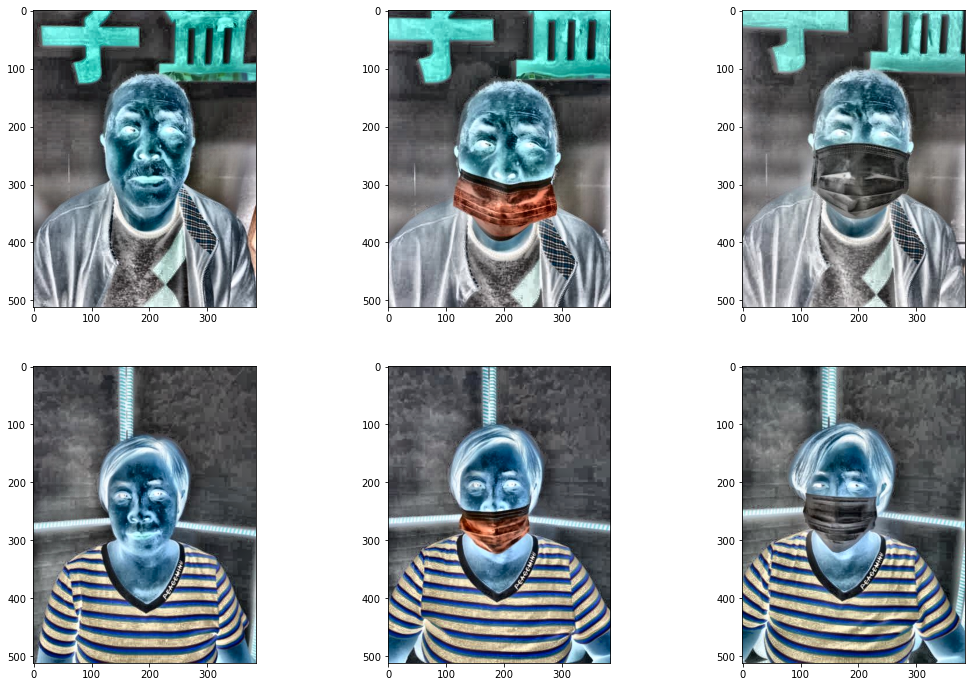

In [14]:
trans3 = A.Compose([A_transforms.InvertImg(p = 1), A_transforms.CLAHE(clip_limit = (10, 10), tile_grid_size = (10, 10), p = 1)
                   ]) 
transformed3_img1 = trans3(image = image1)['image']
transformed3_img2 = trans3(image = image2)['image']
transformed3_img3 = trans3(image = image3)['image']
transformed3_img4 = trans3(image = image4)['image']
transformed3_img5 = trans3(image = image5)['image']
transformed3_img6 = trans3(image = image6)['image']

fig, axes = plt.subplots(2, 3, figsize = (18, 12))
axes[0][0].imshow(transformed3_img1)
axes[0][1].imshow(transformed3_img2)
axes[0][2].imshow(transformed3_img3)

axes[1][0].imshow(transformed3_img4)
axes[1][1].imshow(transformed3_img5)
axes[1][2].imshow(transformed3_img6)
plt.show()

# 4. Sampler
- https://github.com/ufoym/imbalanced-dataset-sampler
- 불균형 데이터에 대해서 어느 정도 효과가 있는지 확인해보자

In [241]:
class Sampler(ImbalancedDatasetSampler):
    def _get_labels(self, dataset):
        if self.callback_get_label:
            return self.callback_get_label(dataset)
        elif isinstance(dataset, torchvision.datasets.MNIST):
            return dataset.train_labels.tolist()
        elif isinstance(dataset, torchvision.datasets.ImageFolder):
            return [x[1] for x in dataset.imgs]
        elif isinstance(dataset, torchvision.datasets.DatasetFolder):
            return dataset.samples[:][1]
        elif isinstance(dataset, torch.utils.data.Subset):
            return dataset.dataset.imgs[:][1]
        elif isinstance(dataset, torch.utils.data.Dataset):
            return dataset.classes
        else:
            raise NotImplementedError

In [239]:
class MaskDataset(Dataset):
    def __init__(self, df, transforms=None, label_filter=None, label='label', template_weight = [0.1, 0.4]):
        """
            Args:
                label_filter : List type으로 입력 (0~17 사잇값으로)
                    ex) label_filter = [1, 2, 5, 7]
        """
        
        self.label_filter = label_filter
        self.label = label
        self.template_weight = template_weight
        if label_filter is not None:
            df = df[df['label'].isin(self.label_filter) == True]
            df = df.reset_index(drop=True)
        self.classes = torch.tensor(df[self.label])
        self.img_path = df.path.values
        self.transforms = transforms
        
    def __len__(self):
        return len(self.classes)

    def __getitem__(self, idx):

        img_path = self.img_path[idx]
        img_path = os.path.join('/opt/ml',img_path)
#         print(img_path)
        label = self.classes[idx]
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        if self.transforms is not None:
            # img_np = np.array(img)
            # print(img_np)
            img = self.transforms(image=img)['image']
            
        template_idx = np.random.randint(low = 0, high = len(self.classes) - 1)
        template_img_path = self.img_path[template_idx]
        template_img_path = os.path.join('/opt/ml',template_img_path)
        template_img = cv2.imread(template_img_path)
        template_img = cv2.cvtColor(template_img, cv2.COLOR_BGR2RGB)
        
        if self.template_weight is not None:    
            self.template_transform = A.Compose([A_transforms.TemplateTransform(templates = template_img, img_weight = (self.template_weight[0], self.template_weight[1])),
                                                A.Resize(height = 384, width = 384),
                                                 A.Normalize(),
                                                ToTensorV2(),
    #                                             시각화를 위해 ToTensorV2()를 주석처리했지만 pytorch에서 tensor로 바꿔야 좋으므로 학습할 때는 주석을 없애주고 실행하면 됨!
                                                ])
        else:
            self.template_transform = A.Compose([A.Resize(height = 384, width = 384),
                                                 A.Normalize(),
                                                 ToTensorV2(),
    #                                             시각화를 위해 ToTensorV2()를 주석처리했지만 pytorch에서 tensor로 바꿔야 좋으므로 학습할 때는 주석을 없애주고 실행하면 됨!
                                                ])
        img = self.template_transform(image=img)['image']


        
        return img, label
    


In [240]:
train_dataset = MaskDataset(df = new_df, transforms = None, template_weight = None)

### 1. 256개

In [243]:
train_loader = DataLoader(train_dataset, batch_size = 256, sampler = Sampler(train_dataset))

In [271]:
for idx, (batch_in, batch_out) in enumerate(train_loader):
    break

In [272]:
label_count = pd.Series(batch_out).value_counts().sort_index()

Text(0.5, 0, 'label')

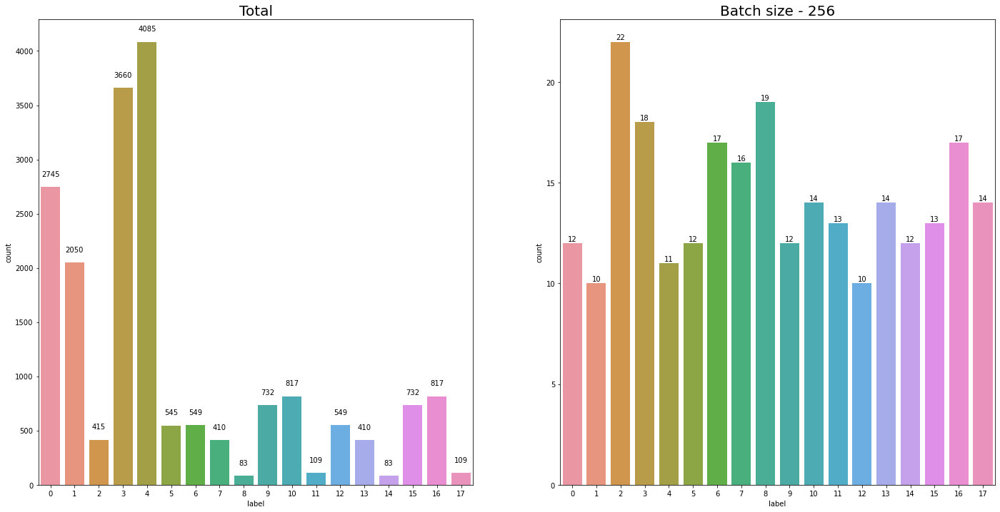

In [279]:
fig = plt.figure(figsize = (24, 12))
ax = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
sns.countplot(data = new_df, x = 'label', ax = ax)
sns.countplot(x = batch_out.numpy(), ax = ax2)
ax.set_title('Total', fontsize = 20)
ax2.set_title('Batch size - 256', fontsize = 20)
for i in range(18):
    ax.text(x = i, y = len(new_df[new_df['label'] == i])+100 , s = len(new_df[new_df['label'] == i]), ha = 'center')
    ax2.text(x = i, y = label_count[i]+0.1 , s = label_count[i], ha = 'center')
ax2.set_xlabel('label')

### 2. 2560개

batch_size = 256 10번 뽑아서 붙인 결과

In [ ]:
y_data = []
for idx, (batch_in, batch_out) in enumerate(train_loader):
    print(idx)
    for label in batch_out.numpy():
        y_data.append(label)
    if idx == 10:
        break

Text(0.5, 0, 'label')

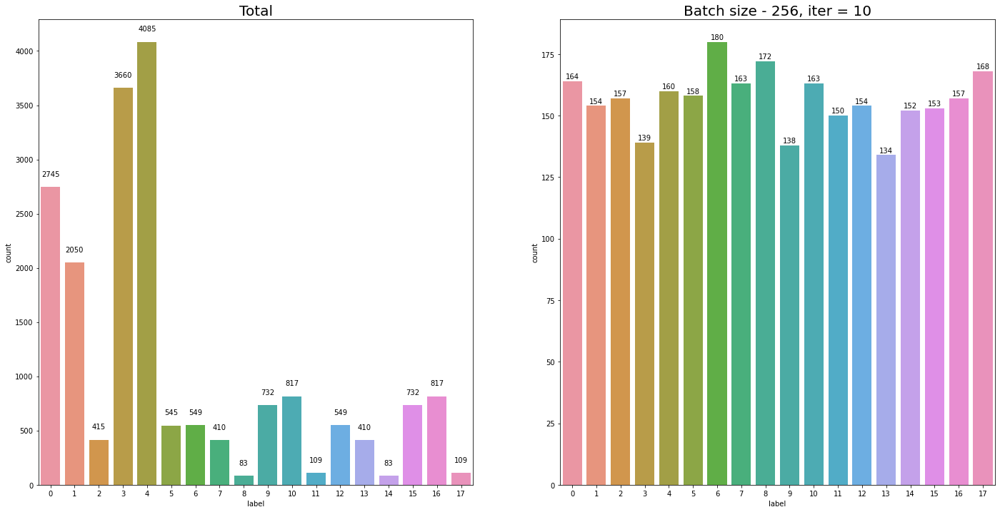

In [280]:
label_count = pd.Series(y_data).value_counts().sort_index()
fig = plt.figure(figsize = (24, 12))
ax = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
sns.countplot(data = new_df, x = 'label', ax = ax)
sns.countplot(x = y_data, ax = ax2)
ax.set_title('Total', fontsize = 20)
ax2.set_title('Batch size - 256, iter = 10', fontsize = 20)
for i in range(18):
    ax.text(x = i, y = len(new_df[new_df['label'] == i])+100 , s = len(new_df[new_df['label'] == i]), ha = 'center')
    ax2.text(x = i, y = label_count[i]+1 , s = label_count[i], ha = 'center')
ax2.set_xlabel('label')

- Sampler와 Augmentation을 적절하게 이용한다면 Imbalanced 문제는 충분히 해결됨

In [3]:
new_df = pd.read_csv("/opt/ml/input/data/train/new_train2.csv")
new_df.tail(10)

,Id,path,label
15565,006957,input/data/train/images/006957_male_Asian_20/m...,0
15566,006957,input/data/train/images/006957_male_Asian_20/m...,0
15567,006957,input/data/train/images/006957_male_Asian_20/m...,0
15568,006959,input/data/train/images/006959_male_Asian_19/n...,12
15569,006959,input/data/train/images/006959_male_Asian_19/i...,6
15570,006959,input/data/train/images/006959_male_Asian_19/m...,0
15571,006959,input/data/train/images/006959_male_Asian_19/m...,0
15572,006959,input/data/train/images/006959_male_Asian_19/m...,0
15573,006959,input/data/train/images/006959_male_Asian_19/m...,0
15574,006959,input/data/train/images/006959_male_Asian_19/m...,0


In [ ]:
new_df['Id'] = new_df['Id'] 